# Algorithms for DNA Sequencing
## Investigator: Ehsan Gharib-Nezhad
LinkedIn: https://www.linkedin.com/in/ehsan-gharib-nezhad/

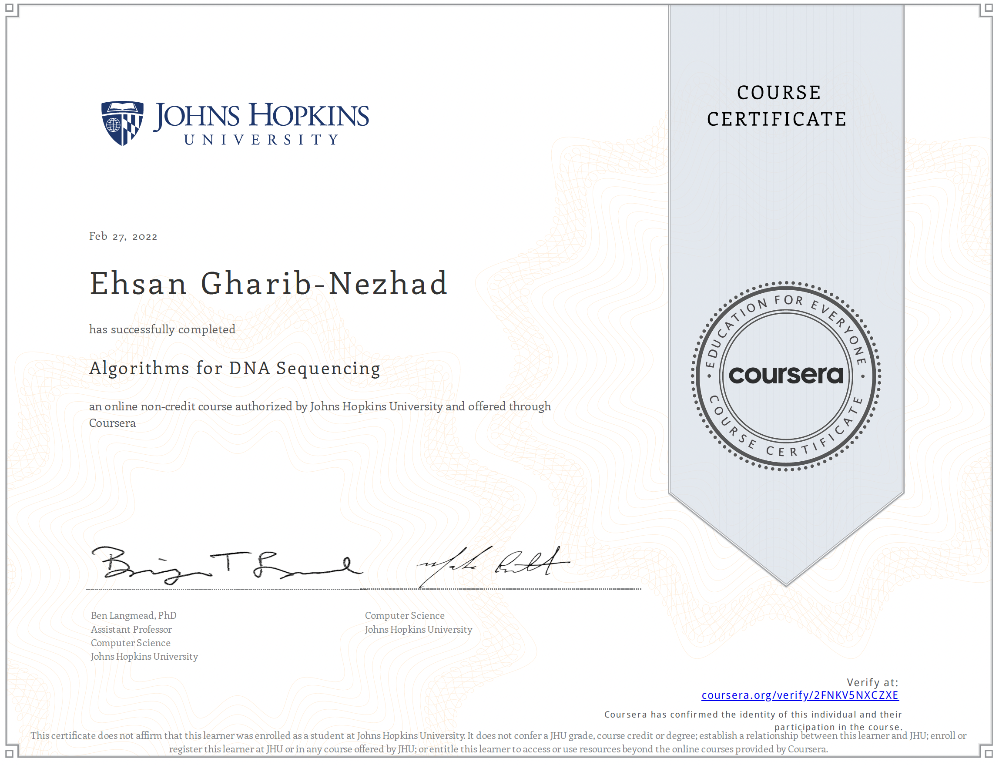
Link: https://www.coursera.org/account/accomplishments/verify/2FNKV5NXCZXE

# ++++++++++++++++++++++++++++++++++++++++++++++++++++++
# WEEK 1 : DNA sequencing, strings and matching
# ++++++++++++++++++++++++++++++++++++++++++++++++++++++

In [128]:
import random
import pandas as pd
import numpy as np
import collections


In [7]:
def make_random_sequence( seq_choice = 'ATCG', 
                          seq_length = 10 ):
    seq = ''.join([random.choice(seq_choice) for _ in range(seq_length)])
    return seq

# test `make_random_sequence` function:
make_random_sequence(seq_length=20)

'TAACACGCCCTGTTCTGAAA'

---

In [10]:
def longestCommonPrefix(seq1, seq2):
    i = 0
    while i < len(seq1) and i < len(seq2) and seq1[i] == seq2[i]:
        i += 1
    return seq1[:i]
        
longestCommonPrefix('ACCATGT', 'ACCAGAC')

'ACCA'

---

In [168]:
def reverseComplement(s):
    complement = {'A': 'T', 'C': 'G', 'G': 'C', 'T': 'A', 'N': 'N'}
    t = ''
    for base in s:
        t = complement[base] + t
    return t

reverseComplement('AATTGC')

'GCAATT'

---

In [169]:
def readGenome(filename):
    genome = ''
    with open(filename, 'r') as f:
        for line in f:
            # ignore header line with genome information
            if not line[0] == '>':
                genome += line.rstrip()
    return genome


genome = readGenome('week1__DNA sequencing strings and matching/lambda_virus.fa')
genome[:100]

'GGGCGGCGACCTCGCGGGTTTTCGCTATTTATGAAAATTTTCCGGTTTAAGGCGTTTCCGTTCTTCTTCGTCATAACTTAATGTTTTTATTTAAAATACC'

---

In [16]:
def count_bases(genome):
    counts = {'A': 0, 'C': 0, 'G': 0, 'T': 0}
    for base in genome:
        counts[base] += 1
    print(counts)
    
count_bases(genome)    

{'A': 12334, 'C': 11362, 'G': 12820, 'T': 11986}


---

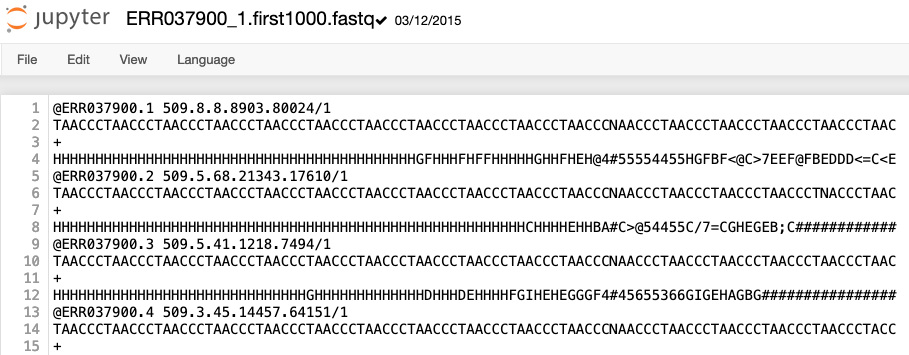

In [725]:
def readFastq(filename):
    sequences = []
    qualities = []
    with open(filename) as fh:
        while True:
            fh.readline()  # skip name line
            seq = fh.readline().rstrip()  # read base sequence
            fh.readline()  # skip placeholder line
            qual = fh.readline().rstrip() # base quality line
            if len(seq) == 0:
                break
            sequences.append(seq)
            qualities.append(qual)
    return sequences, qualities

seqs, quals = readFastq('week1__DNA_sequencing_strings_and_matching/ERR037900_1.first1000.fastq')
seqs[0], quals[0]

('TAACCCTAACCCTAACCCTAACCCTAACCCTAACCCTAACCCTAACCCTAACCCTAACCCTAACCCNAACCCTAACCCTAACCCTAACCCTAACCCTAAC',
 'HHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHGFHHHFHFFHHHHHGHHFHEH@4#55554455HGFBF<@C>7EEF@FBEDDD<=C<E')

In [83]:
# shape
list(map(len, [seqs, seqs[0], quals, quals[0]]))


[1000, 100, 1000, 100]

---

## How to interpret qualities in FASTA files?

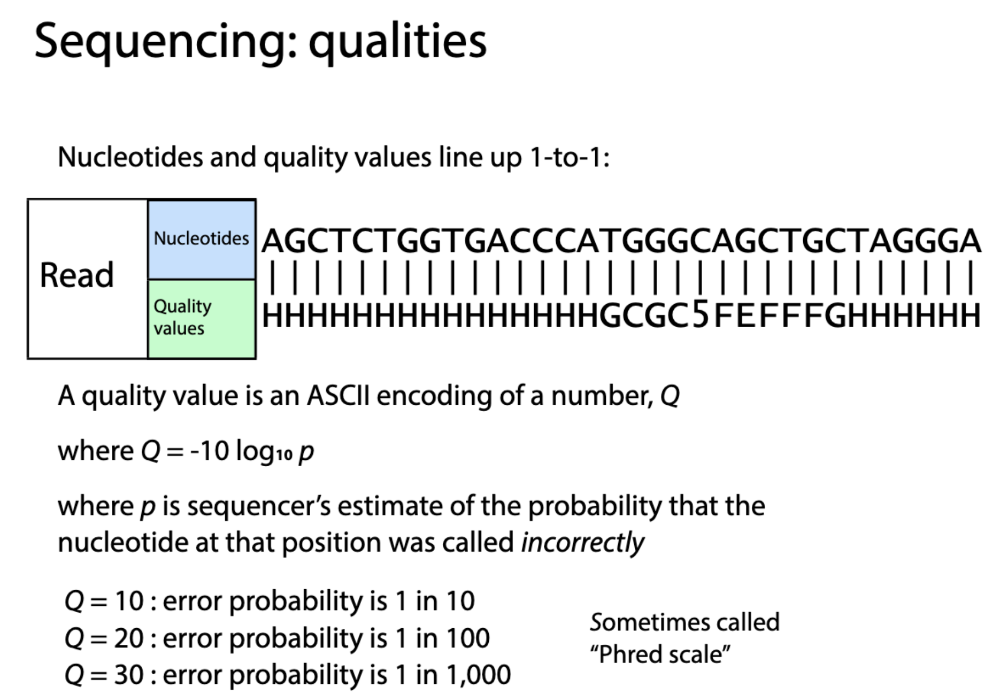

## Note: 

> Higher Q scores indicate a smaller probability of error. \
> Lower Q scores can result in a significant portion of the reads being unusable. 


---

# Sequencing qualitiy functions:

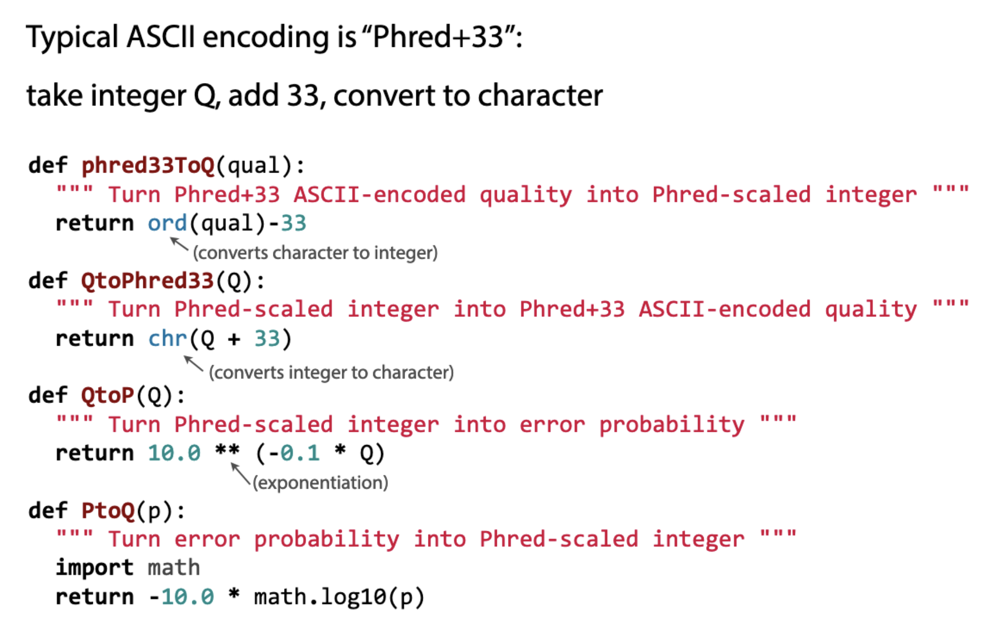


In [80]:
# A Phred quality score is a measure of the quality of the identification 
#   f the nucleobases generated by automated DNA sequencing.

def phred33ToQ(qual):
    """ 
    Note: The ord() function returns Unicode character to an integer.
    """    
    return ord(qual) - 33

list(map(phred33ToQ,['A','B','%', 'H', '@']))

[32, 33, 4, 39, 31]

---

## Calculate the quality value Q from the FASTA file 

In [41]:
pd.DataFrame(quals, columns=['Phred33'])

,Phred33
0,HHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHGFH...
1,HHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHH...
2,HHHHHHHHHHHHHHHHHHHHHHHHHHHHHHGHHHHHHHHHHHHHDH...
3,HHHHHHHHHHHHHHHHHHHHHHHHHIHHHHHHHHHHHHHHHHHHHH...
4,HHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHH...
...,...
995,HHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHHH...
996,HHHHHGHEEHFHHHHHAHHHB<BDBEGEHGHHCHHHEFGGGAGGGG...
997,@?@CAADDADFDFFF4-445CAACADDA>AFFFFFGGEAFA>FGG=...
998,HHHHHHHHHHHGHHHHHHHHHHHHHHHHHHHHHHIHHHHIHHHFHH...


In [91]:
def creatHist(qualities):
    hist = [0] * 100
    for qual in qualities:
        for phred in qual:
            q = phred33ToQ(phred)
            hist[q] += 1
    return hist

h = creatHist(quals)
print(sorted(h))   


[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 11, 11, 23, 28, 55, 86, 100, 111, 174, 185, 259, 272, 286, 317, 351, 390, 403, 413, 538, 694, 762, 777, 971, 1024, 1312, 1341, 1449, 1523, 1916, 2074, 2233, 2782, 3025, 4043, 6640, 17723, 45696]


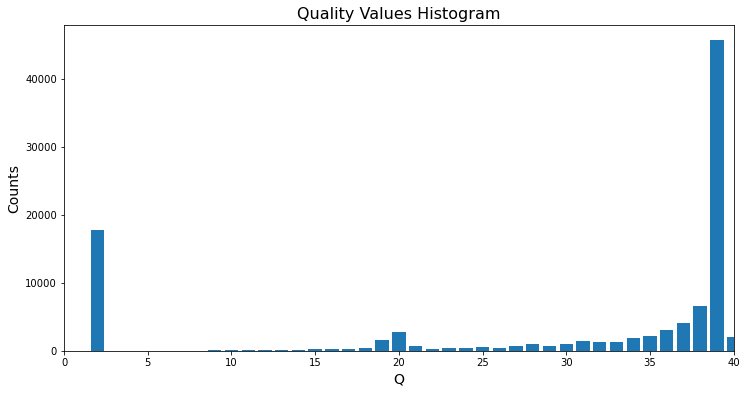

In [92]:
plt.figure(figsize=(12,6))

plt.title('Quality Values Histogram', fontsize = 16)
plt.bar(range(len(h)),h)
plt.xlim(0,40)
plt.ylabel('Counts', fontsize = 14)
plt.xlabel('Q', fontsize = 14);

---

In [381]:
def find_GCAT_ByPos(reads, base_list='C'):
    gc = [0] * 100
    totals = [0] * 100
    
    for read in reads:
        for i in range(len(read)):
            if read[i] == base_list:
                gc[i] += 1
            totals[i] += 1
                
    for i in range(len(gc)):
        if totals[i] > 0:
            gc[i] /=float(totals[i])
            
    return gc 

In [382]:
# Check reads in 
pd.DataFrame(seqs, columns=['seqs'])

,seqs
0,TAACCCTAACCCTAACCCTAACCCTAACCCTAACCCTAACCCTAAC...
1,TAACCCTAACCCTAACCCTAACCCTAACCCTAACCCTAACCCTAAC...
2,TAACCCTAACCCTAACCCTAACCCTAACCCTAACCCTAACCCTAAC...
3,TAACCCTAACCCTAACCCTAACCCTAACCCTAACCCTAACCCTAAC...
4,AACCCTAACCCTAACCCTAACCCTAACCCTAACCCTAACCCTAACC...
...,...
995,CTCTGCCAGGCCTTGGAGCCAGACTAGGAGGCTTTATAGGCCACCG...
996,AACGGAGCAGCTGGTGATGTGTGGGCCCACCGGCCCCAGGCTCCTG...
997,CACCCTCTTGATCTTCCCTGTGATGTCATCTGGAGCCCTGCTGCTT...
998,CTGGGAAAGACTCTGCCAGGCCTTGGAGCCAGACTAGGAGGCTTTA...


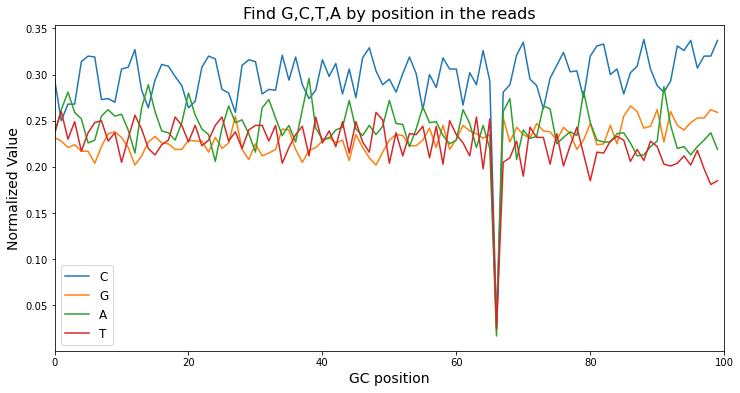

In [383]:
C, G, T, A = [find_GCAT_ByPos(seqs, base_list=base) for base in ['C', 'G', 'T', 'A'] ]

plt.figure(figsize=(12,6))
plt.title('Find G,C,T,A by position in the reads', fontsize = 16)
plt.plot(range(len(C)), C, label='C')
plt.plot(range(len(G)), G, label='G')
plt.plot(range(len(A)), A, label='A')
plt.plot(range(len(T)), T, label='T')

plt.xlim(0,100)
plt.legend(fontsize = 12)
plt.ylabel('Normalized Value', fontsize = 14)
plt.xlabel('GC position', fontsize = 14);

---

In [154]:
# seqs

In [134]:
def count_ATGC_in_seqs(seqs):
    """  N is when there is no confidance, N means No confidance """
    count = collections.Counter()
    for seq in seqs:
        count.update(seq)
    return count


<BarContainer object of 5 artists>

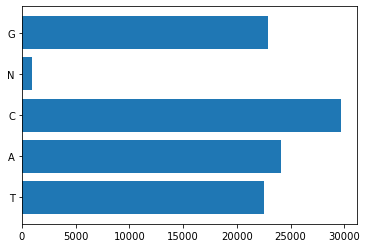

In [159]:
count_GCTA = count_ATGC_in_seqs(seqs) 
plt.barh(  list(count_GCTA.keys()), list(count_GCTA.values()) )

---

# ||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||
# Naive Exact Matching / Brute Force Algorithm
# ||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||


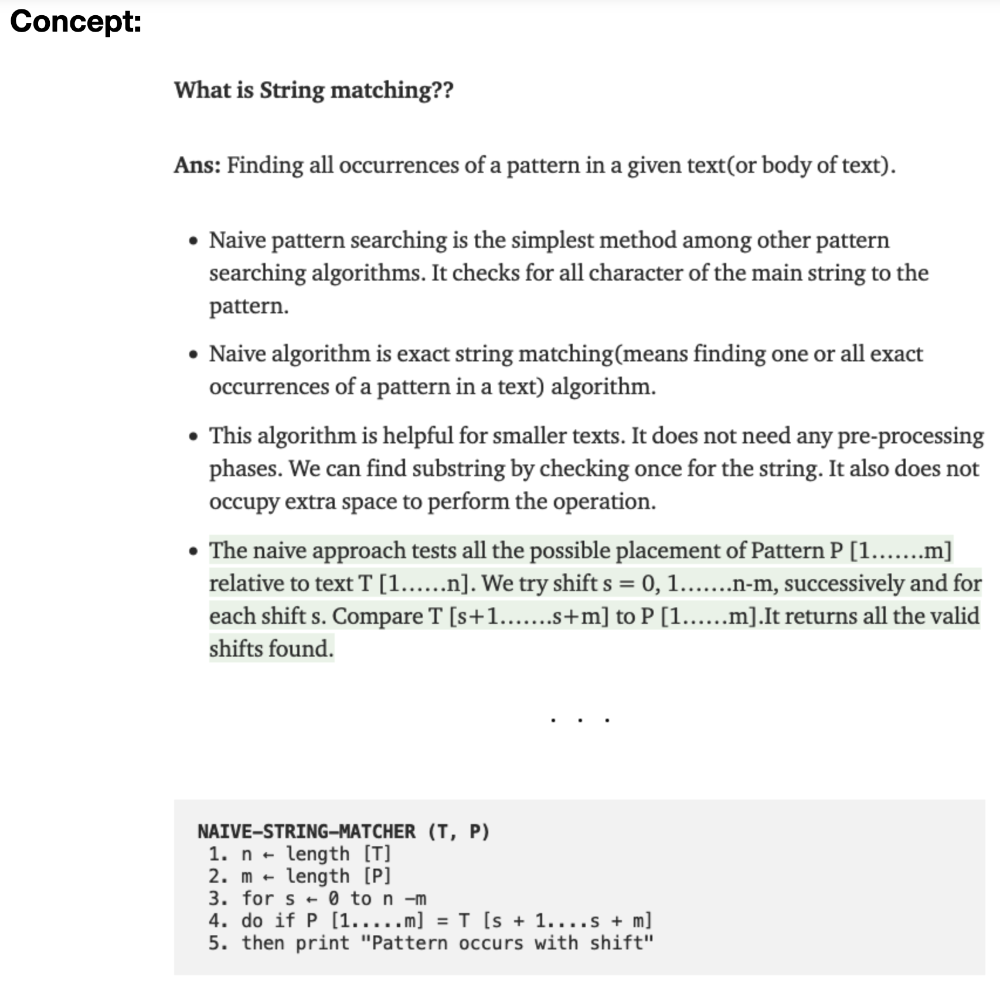

Reference: https://medium.com/@krupa_110/the-naive-string-matching-algorithm-be7992ebbd1d

In [161]:
# naive exact matching algorithm
# Returns a list of occurrences (offset)
def naive(p, t):
    """
    p : pattern
    t : text, sequence, or genome
    """
    occurrences = []
    for i in range(len(t) - len(p) + 1):  # loop over alignments
        match = True
        for j in range(len(p)):  # loop over characters
            if t[i+j] != p[j]:  # compare characters
                match = False
                break
        if match:
            occurrences.append(i)  # all chars matched; record
    return occurrences

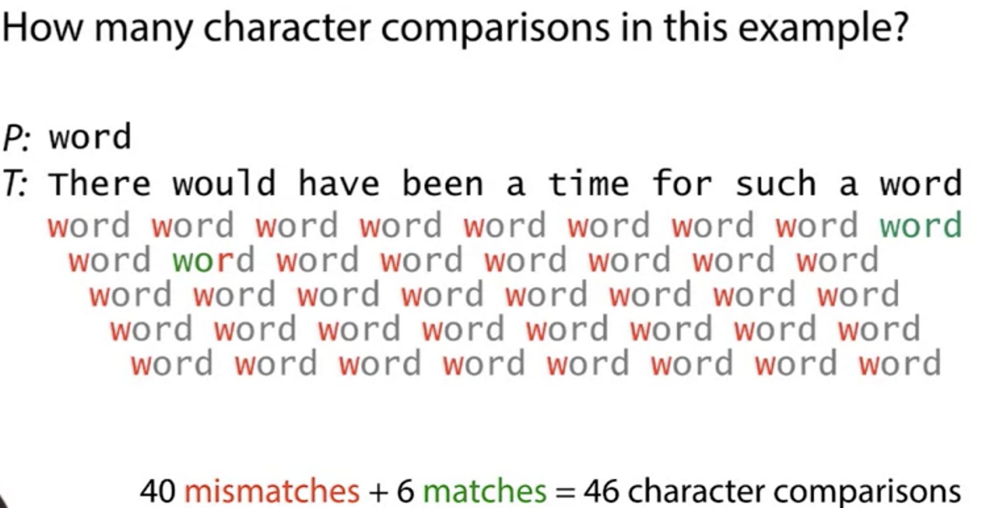

In [166]:
# example
text = 'I Can Speak French but Cannot read'
patten = 'ea'
print(f'number of alignments in this question is: {len(text) - len(patten) + 1}')
naive(patten, text)

number of alignments in this question is: 33


[8, 31]

In [164]:
text[8:10], text[31:33]

('ea', 'ea')

---

In [223]:

# naive exact matching algorithm with reverse occurrance 
# Returns a list of occurrences (offset)
def naive_with_rc(p, t, 
                  Forward = True,
                  Reserve = True,
                    ):
    """
    Use: looks for occurrences of P in T, additionally look for 
            occurrences of the reverse complement of P in T. 
    p : pattern
    t : text, sequence, or genome
    """
    occurrences = []
    
    # Count Forward alignments
    if Forward:
        for i in range(len(t) - len(p) + 1):  # loop over alignments
            match = True
            for j in range(len(p)):  # loop over characters
                if t[i+j] != p[j]:  # compare characters
                    match = False
                    break
            if match:
                occurrences.append(i)  # all chars matched; record
    
    
    # Count Reverse alignments
    if Reserve:
        occurrences_reverse = []
        p = reverseComplement(p)
        for i in range(len(t) - len(p) + 1):  # loop over alignments
            match = True
            for j in range(len(p)):  # loop over characters
                if t[i+j] != p[j]:  # compare characters
                    match = False
                    break
            if match:
                occurrences.append(i)  # all chars matched; record

    # Count Reverse alignments
    return occurrences

In [224]:
print('occurrences, occurrences_reverse:', naive_with_rc('AG', 'AGGAAGACT'))

occurrences, occurrences_reverse: [0, 4, 7]


---

In [353]:
# naive exact matching algorithm with reverse occurrance 
# Returns a list of occurrences (offset)
def naive_2mm(p, t, 
                  mismatch_total = 1,
                  Forward = True,
                  Reserve = False,
                    ):
    """
    Use: looks for occurrences of P in T, additionally look for 
            occurrences of the reverse complement of P in T. 
    p : pattern
    t : text, sequence, or genome
    """
    occurrences = []
    
    # Count Forward alignments
    if Forward:
            for i in range(len(t) - len(p) + 1):  # loop over alignments
                match = True
                mismatch_count = 0
                for j in range(len(p)):  # loop over characters
                    if t[i+j] != p[j]:  # compare characters
                        mismatch_count+=1

                        if mismatch_count > mismatch_total:
                            match = False
                            break
                if match:
                    occurrences.append(i)  # all chars matched; record
                    
#                     match = False
#             if match:
#                 MatchNumber +=1
    
    
#     # Count Reverse alignments
#     if Reserve:
#         occurrences_reverse = []
#         p = reverseComplement(p)
#         for i in range(len(t) - len(p) + 1):  # loop over alignments
#             match = True
#             for j in range(len(p)):  # loop over characters
#                 if t[i+j] != p[j]:  # compare characters
#                     match = False
#                     break
#             if match:
#                 occurrences.append(i)  # all chars matched; record

    # Count Reverse alignments
    return occurrences

In [354]:
t='GTCGACGG'
p='TGG'
mismatch_total=1

# naive_with_rc(p, t, Reserve=False)
naive_2mm(p, t, mismatch_total)

[1, 5]

-----

# Programming Homework 1

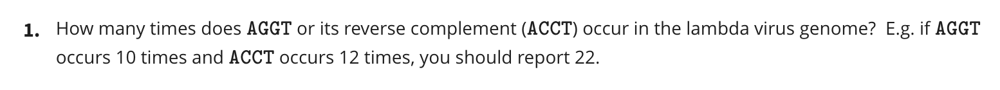

In [225]:
genome_lambda_virus = readGenome('week1__DNA_sequencing_strings_and_matching/lambda_virus.fa')

In [226]:
occurance_AGGT_with_reverse = naive_with_rc('AGGT', genome_lambda_virus)

In [227]:
print(f'The number of occurance of "AGGT" including its reverse in lambda virus genome is:\
      {len(occurance_AGGT_with_reverse)}')

The number of occurance of "AGGT" including its reverse in lambda virus genome is:      306


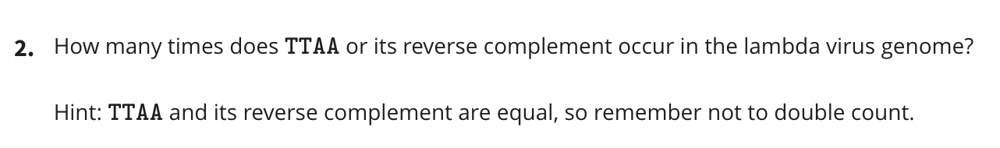

In [228]:
occurance_TTAA = naive('TTAA', genome_lambda_virus)

In [229]:
print(f'The number of occurance of "AGGT" including its reverse in lambda virus genome is:\
      {len(occurance_TTAA)}')

The number of occurance of "AGGT" including its reverse in lambda virus genome is:      195


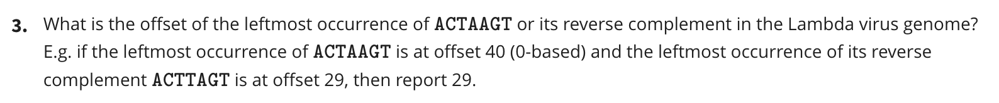

In [238]:
occurance_ACCTAAGT_with_reverse = naive_with_rc('ACTAAGT', genome_lambda_virus, Forward=False)

In [239]:
occurance_ACCTAAGT_with_reverse

[26028]

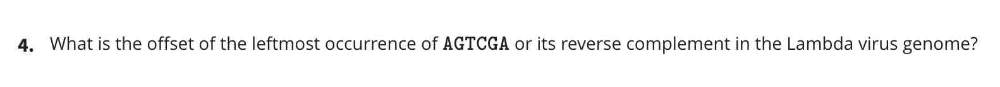

In [242]:
occurance_ACCTAAGT_with_reverse = naive_with_rc('AGTCGA', genome_lambda_virus)
min(occurance_ACCTAAGT_with_reverse)

450

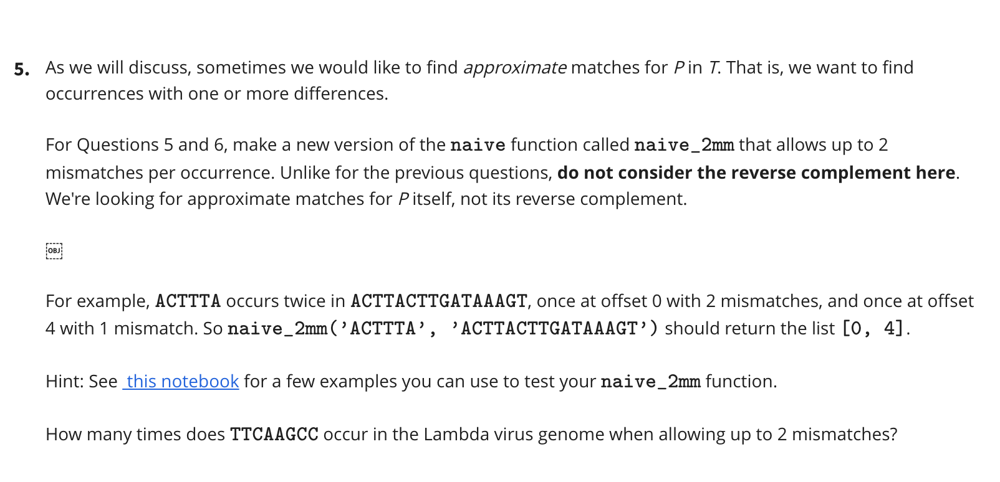

In [357]:
occurance_ACTTTA_approx_match = naive_2mm('ACTTTA', genome_lambda_virus, mismatch_total=2)

In [358]:
len( occurance_ACTTTA_approx_match )

1605

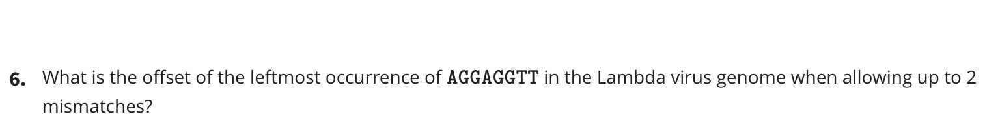

In [359]:
occurances = naive_2mm('AGGAGGTT', genome_lambda_virus, mismatch_total=2)

min(occurances)

49

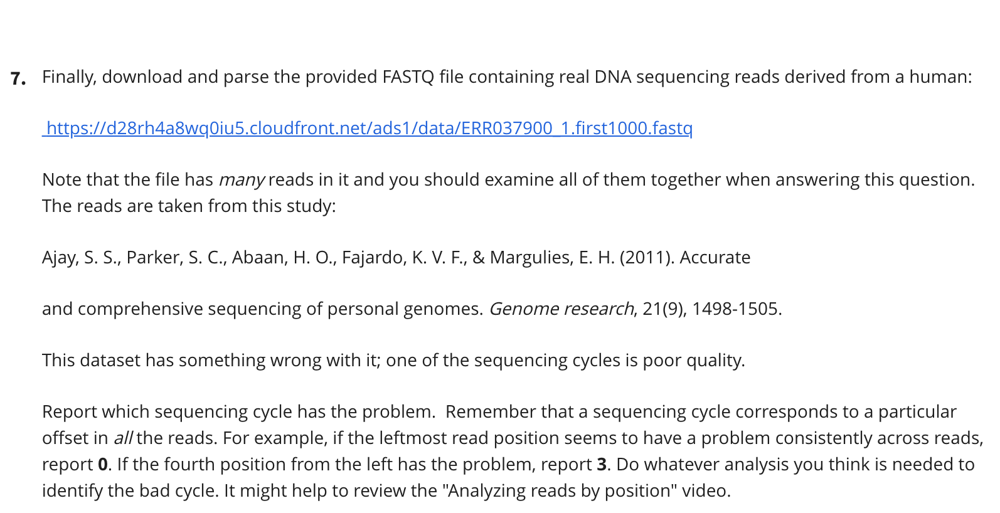

In [375]:
seqs, quals = readFastq('week1__DNA_sequencing_strings_and_matching/ERR037900_1.first1000.fastq')

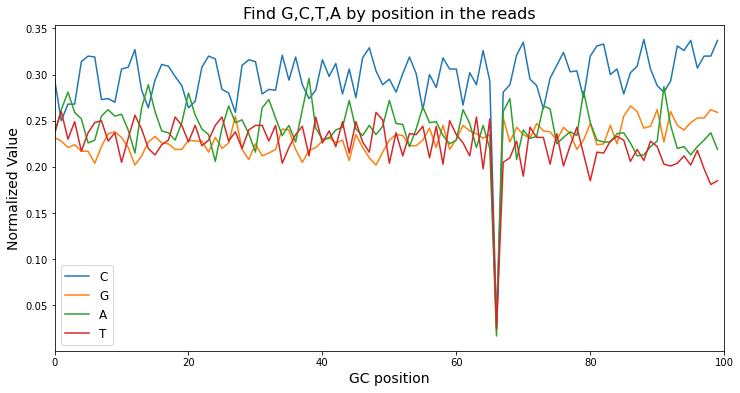

In [384]:
C, G, T, A = [find_GCAT_ByPos(seqs, base_list=base) for base in ['C', 'G', 'T', 'A'] ]

plt.figure(figsize=(12,6))
plt.title('Find G,C,T,A by position in the reads', fontsize = 16)
plt.plot(range(len(C)), C, label='C')
plt.plot(range(len(G)), G, label='G')
plt.plot(range(len(A)), A, label='A')
plt.plot(range(len(T)), T, label='T')

plt.xlim(0,100)
plt.legend(fontsize = 12)
plt.ylabel('Normalized Value', fontsize = 14)
plt.xlabel('GC position', fontsize = 14);

In [367]:
[base.index(min(base)) for base in [C,G,T,A]]

[66, 66, 66, 66]

#  
#  
# ++++++++++++++++++++++++++++++++++++++++++++++++++++++
# WEEK 2 : Preprocessing, indexing and approximate matching
# ++++++++++++++++++++++++++++++++++++++++++++++++++++++

# Boyer-Moore Algorithm

## Concept: 
Reference: https://maksimdan.gitbook.io/ecs122a-algorithm-design-lecture-notes/string-algorithms/boyer-moore


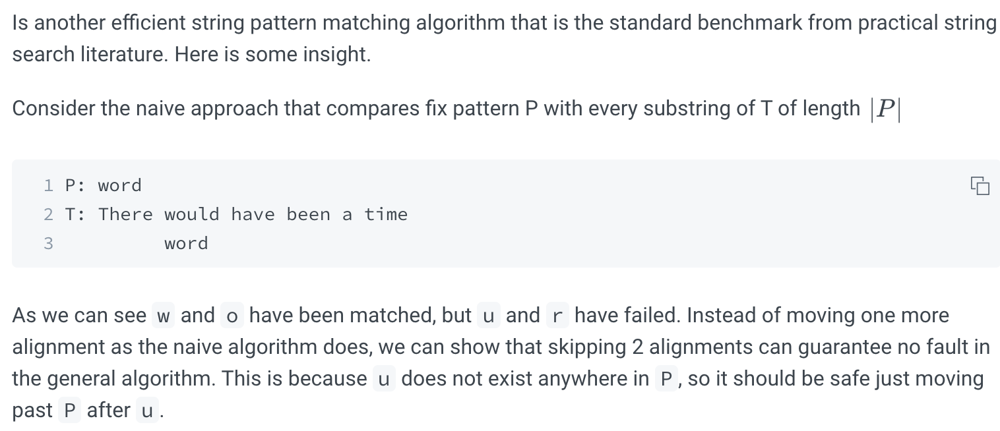

---

# Boyer-Moore Rules:
Reference: https://maksimdan.gitbook.io/ecs122a-algorithm-design-lecture-notes/string-algorithms/boyer-moore

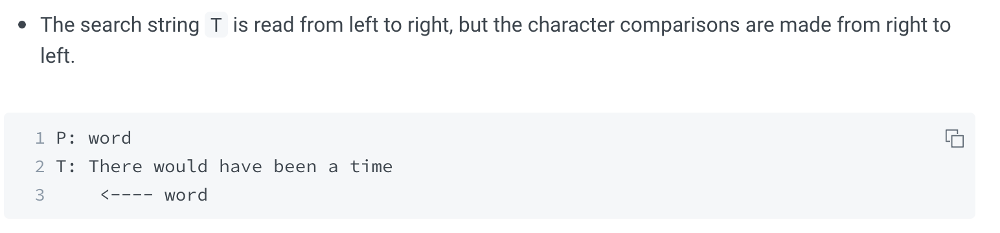

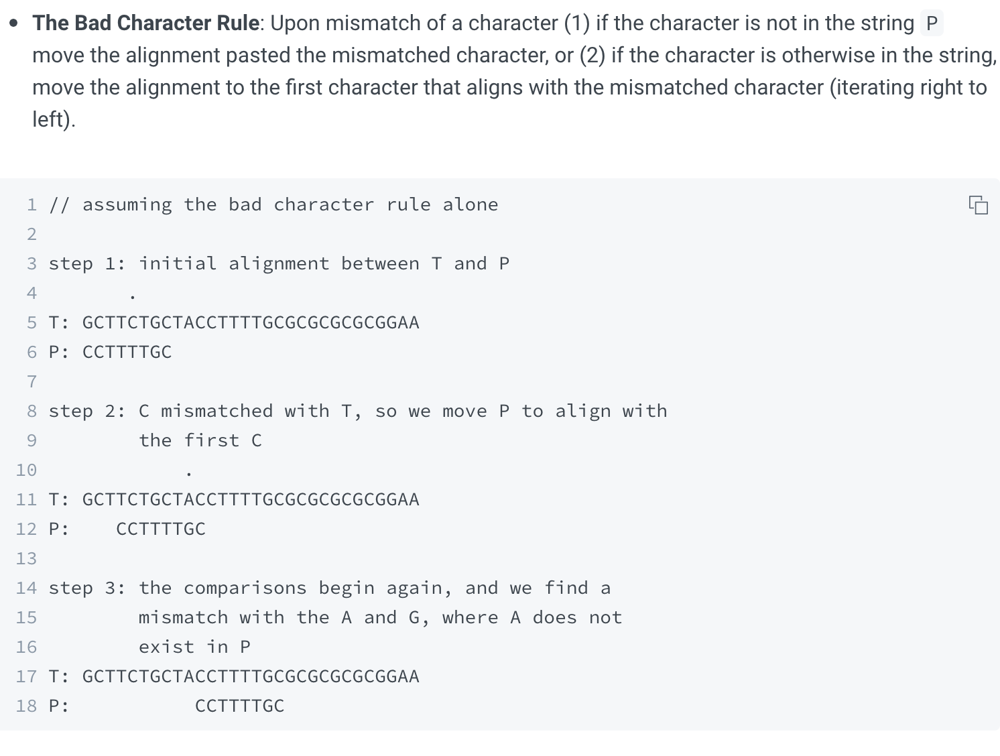

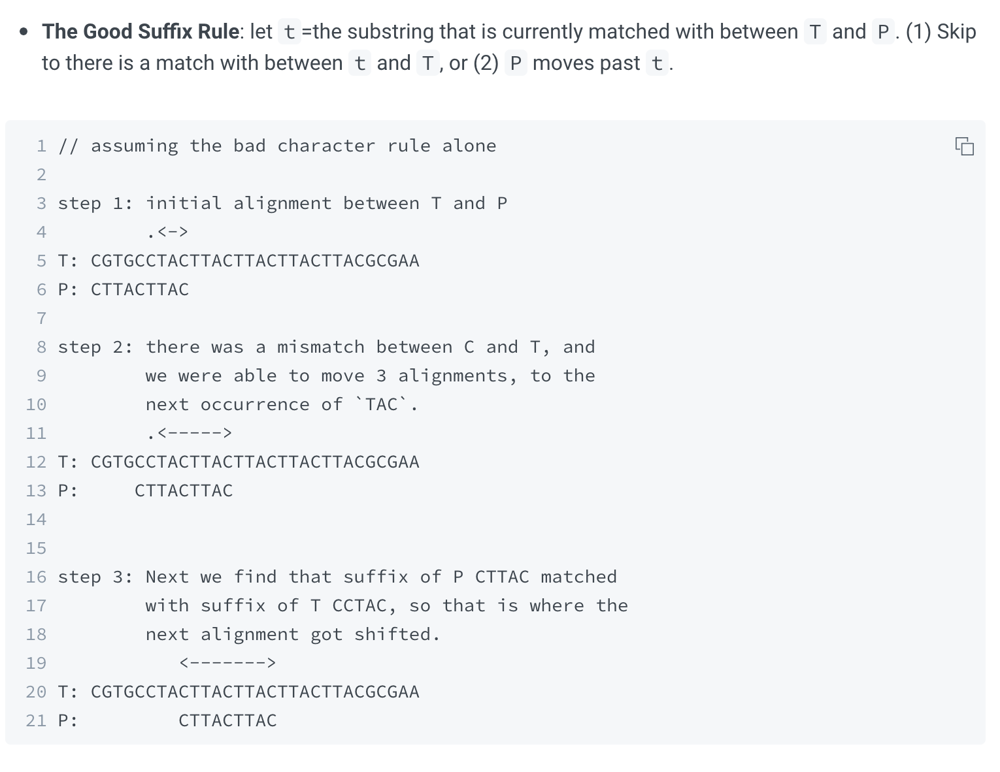

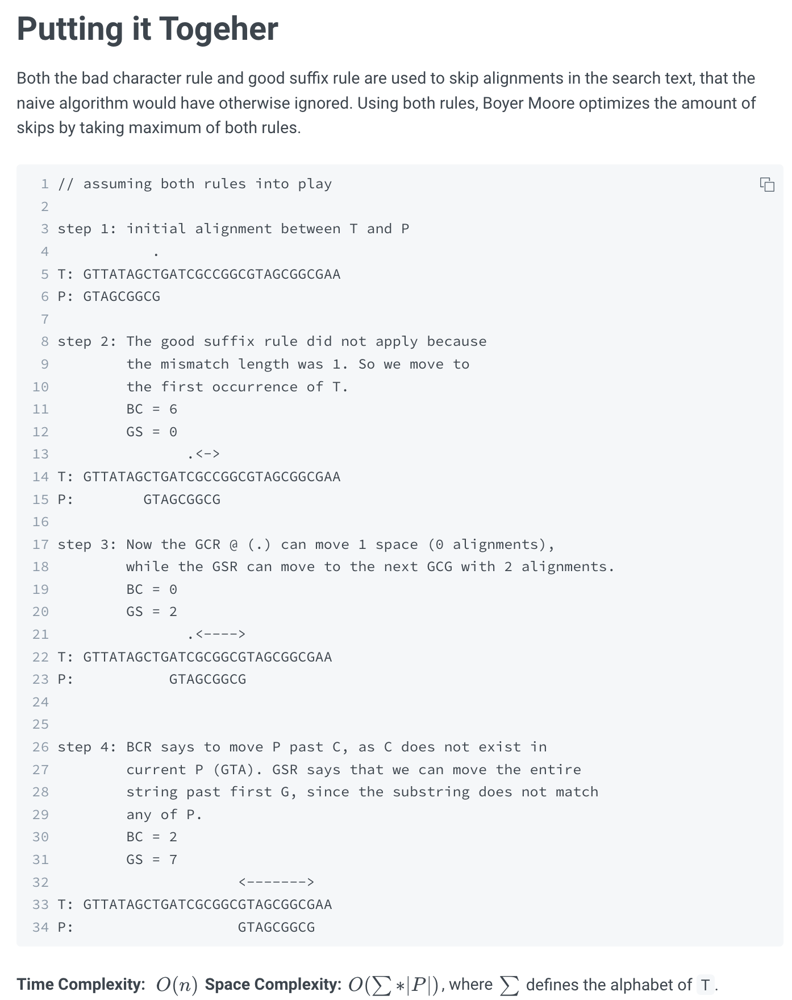

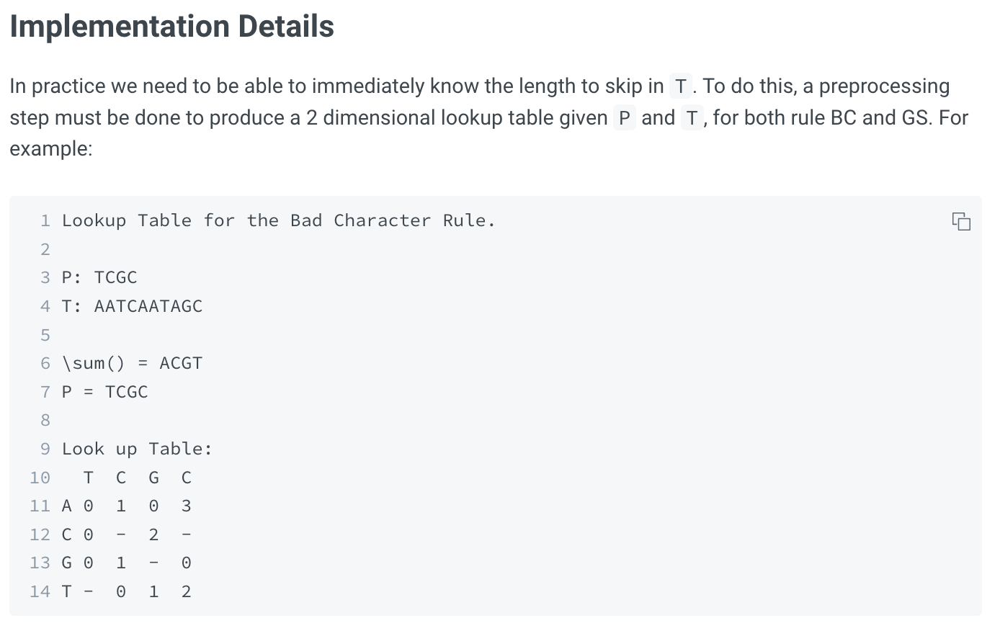

---

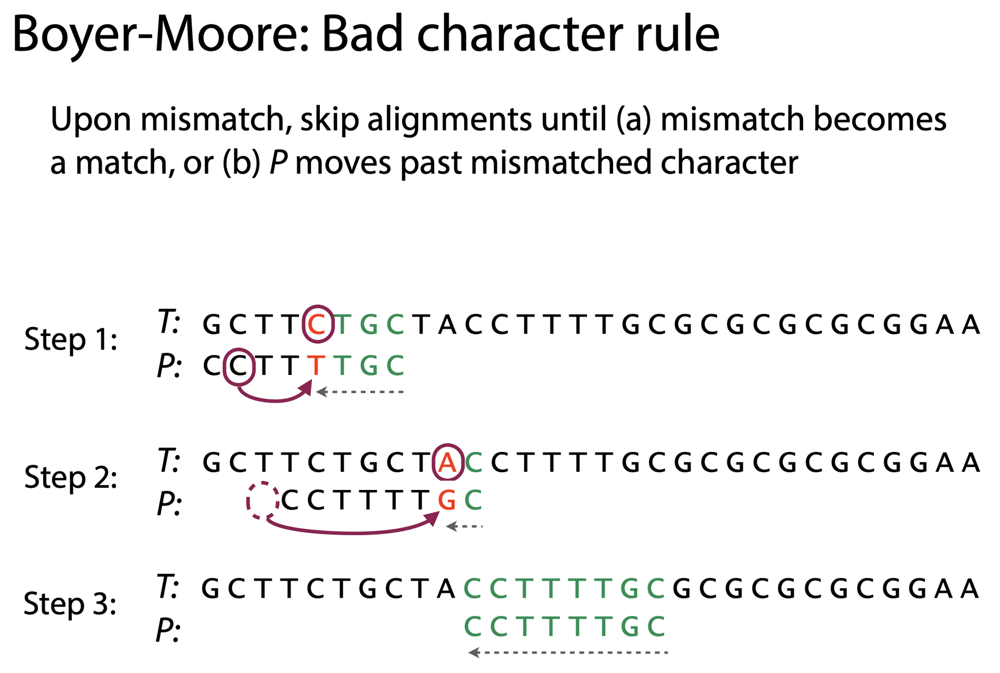

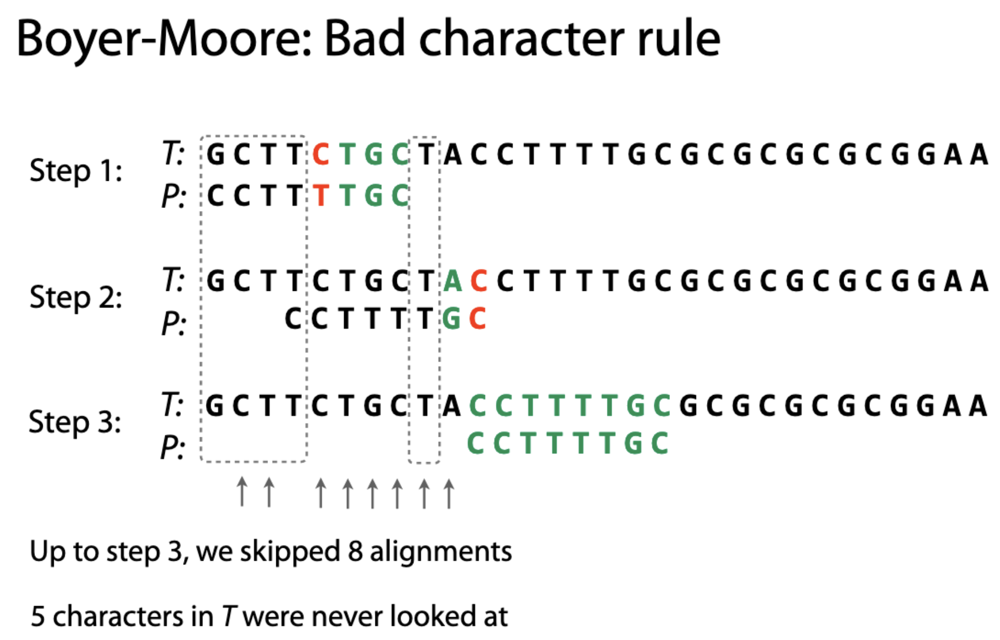
---

---

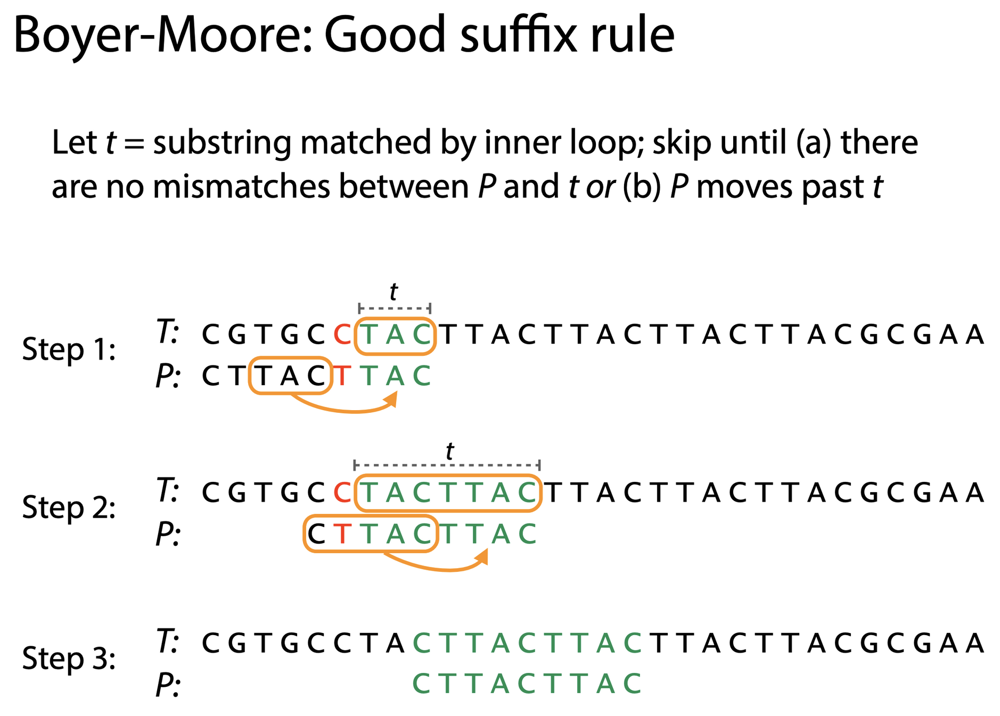

---

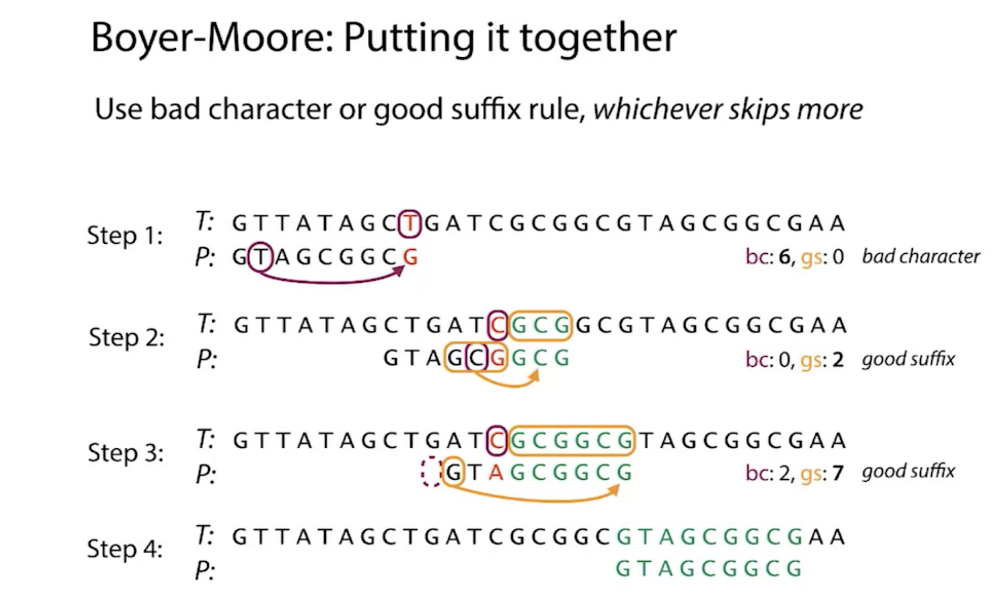

In [407]:
#!/usr/bin/env python

"""bm_preproc.py: Boyer-Moore preprocessing."""

__author__ = "Ben Langmead"

import unittest


def z_array(s):
    """ Use Z algorithm (Gusfield theorem 1.4.1) to preprocess s """
    assert len(s) > 1
    z = [len(s)] + [0] * (len(s)-1)

    # Initial comparison of s[1:] with prefix
    for i in range(1, len(s)):
        if s[i] == s[i-1]:
            z[1] += 1
        else:
            break

    r, l = 0, 0
    if z[1] > 0:
        r, l = z[1], 1

    for k in range(2, len(s)):
        assert z[k] == 0
        if k > r:
            # Case 1
            for i in range(k, len(s)):
                if s[i] == s[i-k]:
                    z[k] += 1
                else:
                    break
            r, l = k + z[k] - 1, k
        else:
            # Case 2
            # Calculate length of beta
            nbeta = r - k + 1
            zkp = z[k - l]
            if nbeta > zkp:
                # Case 2a: zkp wins
                z[k] = zkp
            else:
                # Case 2b: Compare characters just past r
                nmatch = 0
                for i in range(r+1, len(s)):
                    if s[i] == s[i - k]:
                        nmatch += 1
                    else:
                        break
                l, r = k, r + nmatch
                z[k] = r - k + 1
    return z


def n_array(s):
    """ Compile the N array (Gusfield theorem 2.2.2) from the Z array """
    return z_array(s[::-1])[::-1]


def big_l_prime_array(p, n):
    """ Compile L' array (Gusfield theorem 2.2.2) using p and N array.
        L'[i] = largest index j less than n such that N[j] = |P[i:]| """
    lp = [0] * len(p)
    for j in range(len(p)-1):
        i = len(p) - n[j]
        if i < len(p):
            lp[i] = j + 1
    return lp


def big_l_array(p, lp):
    """ Compile L array (Gusfield theorem 2.2.2) using p and L' array.
        L[i] = largest index j less than n such that N[j] >= |P[i:]| """
    l = [0] * len(p)
    l[1] = lp[1]
    for i in range(2, len(p)):
        l[i] = max(l[i-1], lp[i])
    return l


def small_l_prime_array(n):
    """ Compile lp' array (Gusfield theorem 2.2.4) using N array. """
    small_lp = [0] * len(n)
    for i in range(len(n)):
        if n[i] == i+1:  # prefix matching a suffix
            small_lp[len(n)-i-1] = i+1
    for i in range(len(n)-2, -1, -1):  # "smear" them out to the left
        if small_lp[i] == 0:
            small_lp[i] = small_lp[i+1]
    return small_lp


def good_suffix_table(p):
    """ Return tables needed to apply good suffix rule. """
    n = n_array(p)
    lp = big_l_prime_array(p, n)
    return lp, big_l_array(p, lp), small_l_prime_array(n)


def good_suffix_mismatch(i, big_l_prime, small_l_prime):
    """ Given a mismatch at offset i, and given L/L' and l' arrays,
        return amount to shift as determined by good suffix rule. """
    length = len(big_l_prime)
    assert i < length
    if i == length - 1:
        return 0
    i += 1  # i points to leftmost matching position of P
    if big_l_prime[i] > 0:
        return length - big_l_prime[i]
    return length - small_l_prime[i]


def good_suffix_match(small_l_prime):
    """ Given a full match of P to T, return amount to shift as
        determined by good suffix rule. """
    return len(small_l_prime) - small_l_prime[1]


def dense_bad_char_tab(p, amap):
    """ Given pattern string and list with ordered alphabet characters, create
        and return a dense bad character table.  Table is indexed by offset
        then by character. """
    tab = []
    nxt = [0] * len(amap)
    for i in range(0, len(p)):
        c = p[i]
        assert c in amap
        tab.append(nxt[:])
        nxt[amap[c]] = i+1
    return tab


class BoyerMoore(object):
    """ Encapsulates pattern and associated Boyer-Moore preprocessing. """

    def __init__(self, p, alphabet='ACGT'):
        # Create map from alphabet characters to integers
        self.amap = {alphabet[i]: i for i in range(len(alphabet))}
        # Make bad character rule table
        self.bad_char = dense_bad_char_tab(p, self.amap)
        # Create good suffix rule table
        _, self.big_l, self.small_l_prime = good_suffix_table(p)

    def bad_character_rule(self, i, c):
        """ Return # skips given by bad character rule at offset i """
        assert c in self.amap
        assert i < len(self.bad_char)
        ci = self.amap[c]
        return i - (self.bad_char[i][ci]-1)

    def good_suffix_rule(self, i):
        """ Given a mismatch at offset i, return amount to shift
            as determined by (weak) good suffix rule. """
        length = len(self.big_l)
        assert i < length
        if i == length - 1:
            return 0
        i += 1  # i points to leftmost matching position of P
        if self.big_l[i] > 0:
            return length - self.big_l[i]
        return length - self.small_l_prime[i]

    def match_skip(self):
        """ Return amount to shift in case where P matches T """
        return len(self.small_l_prime) - self.small_l_prime[1]




In [408]:
def boyer_moore(p, p_bm, t):
    """ Do Boyer-Moore matching. 
        p=pattern, 
        t=text,
        p_bm=BoyerMoore object for p """
    i = 0
    occurrences = []
    while i < len(t) - len(p) + 1:
        shift = 1
        mismatched = False
        for j in range(len(p)-1, -1, -1):
            if p[j] != t[i+j]:
                skip_bc = p_bm.bad_character_rule(j, t[i+j])
                skip_gs = p_bm.good_suffix_rule(j)
                shift = max(shift, skip_bc, skip_gs)
                mismatched = True
                break
        if not mismatched:
            occurrences.append(i)
            skip_gs = p_bm.match_skip()
            shift = max(shift, skip_gs)
        i += shift
    return occurrences


In [476]:
def boyer_moore_with_counts(p, p_bm, t):
    """ Do Boyer-Moore matching with counts. 
        p=pattern, 
        t=text,
        p_bm=BoyerMoore object for p 
        Developed by: https://github.com/jordancheah"""
    i = 0
    occurrences = []
    num_alignments = 0
    num_character_comparisons = 0
    while i < len(t) - len(p) + 1:
        shift = 1
        mismatched = False
        num_alignments += 1
        for j in range(len(p)-1, -1, -1):
            num_character_comparisons += 1
            if p[j] != t[i+j]:
                skip_bc = p_bm.bad_character_rule(j, t[i+j])
                skip_gs = p_bm.good_suffix_rule(j)
                shift = max(shift, skip_bc, skip_gs)
                mismatched = True
                break
        if not mismatched:
            occurrences.append(i)
            skip_gs = p_bm.match_skip()
            shift = max(shift, skip_gs)
        i += shift
    return occurrences, num_alignments, num_character_comparisons


## Example 1

In [477]:
t = 'GGCTATAATGCGTA'
p = 'TAATAAA'
p_bm = BoyerMoore(p)
p_bm.match_skip()
print ('Text:  %s' % t)
print ('Match: %s%s' % ('.'*p_bm.match_skip(), p))
print ('Match Skip:', p_bm.match_skip())


Text:  GGCTATAATGCGTA
Match: .......TAATAAA
Match Skip: 7


## Example 2

In [487]:
p = 'word'
t = 'there would have been a time for such a word'
lowercase_alphabet = 'abcdefghijklmnopqrstuvwxyz '
p_bm = BoyerMoore(p, lowercase_alphabet)
occurrences, num_alignments, num_character_comparisons = boyer_moore_with_counts(p, p_bm, t)
list(zip(['occurrences:', 'num_alignments:', 'num_character_comparisons:'], 
               [occurrences, num_alignments, num_character_comparisons]))

[('occurrences:', [40]),
 ('num_alignments:', 12),
 ('num_character_comparisons:', 15)]

## Example 3

In [486]:
p = 'needle'
t = 'needle need noodle needle'
p_bm = BoyerMoore(p, lowercase_alphabet)
occurrences, num_alignments, num_character_comparisons = boyer_moore_with_counts(p, p_bm, t)
list(zip(['occurrences:', 'num_alignments:', 'num_character_comparisons:'], 
               [occurrences, num_alignments, num_character_comparisons]))

[('occurrences:', [0, 19]),
 ('num_alignments:', 5),
 ('num_character_comparisons:', 18)]

---

# Indexing and the k-mer index

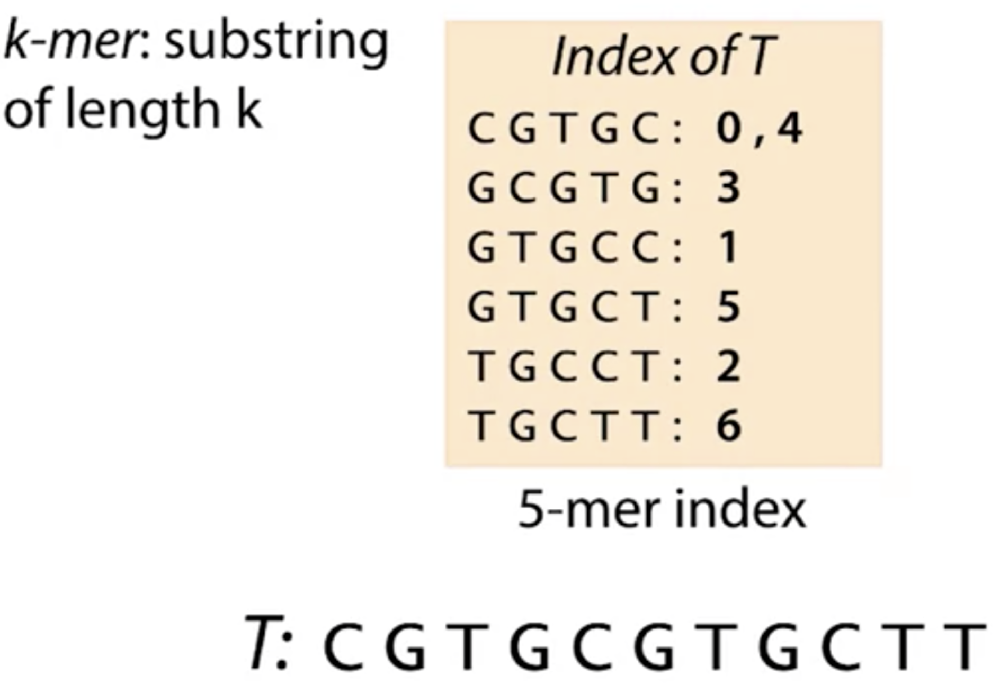

# Querying the Index

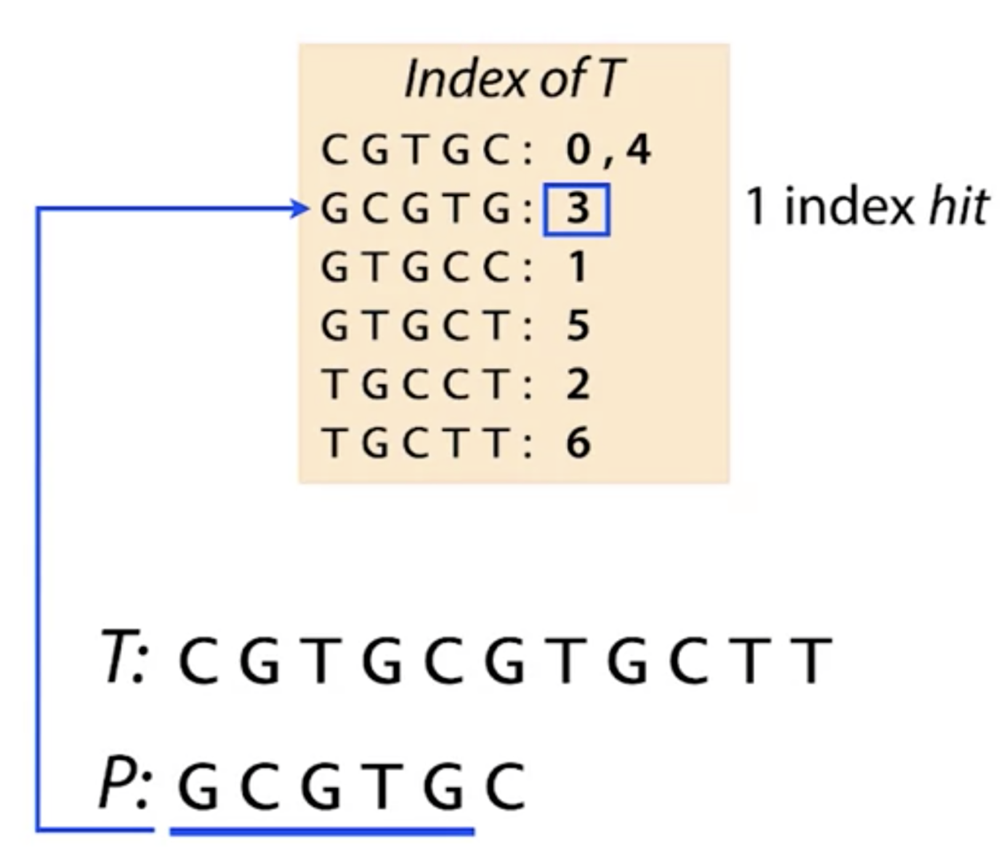

# 
# 
# Programming Homework 2
# 

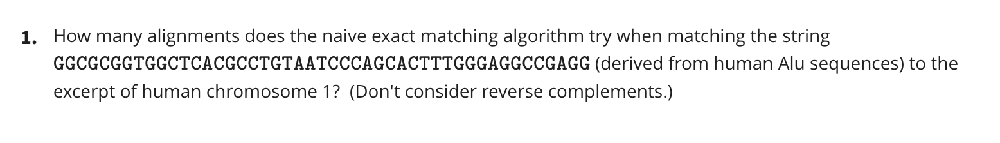

In [439]:
def readFastq_allSequence(filename):
    sequences = []
    with open(filename) as fh:
        while True:
            seq = fh.readline().rstrip()  # read base sequence
            if len(seq) == 0:
                break
            sequences.append(seq)
    return sequences[1:]


In [440]:
seqs= readFastq_allSequence('week2__Preprocessing_indexing_and_approximate_matching/chr1.GRCh38.excerpt.fasta')

In [497]:
seqs[:3]

['TTGAATGCTGAAATCAGCAGGTAATATATGATAATAGAGAAAGCTATCCCGAAGGTGCATAGGTCAACAATACTTGAGCC',
 'TAACTCAGTAGATCCTAAAAGAAAGCAATTTTTGCTGCTAACCTAACATTTCACAATGTCTGGAGACATTTACAGTTCCC',
 'ACAACCTATGGCAGTTACTGGCATCTACTAGAGGTCAGAGATGCTGGTAAATACTCTGTAATGAACAAGAAGCCCCCCAT']

In [495]:
# join all seqs togather 
chromosome1 = ''.join(seqs)

In [498]:
chromosome1[:100]

'TTGAATGCTGAAATCAGCAGGTAATATATGATAATAGAGAAAGCTATCCCGAAGGTGCATAGGTCAACAATACTTGAGCCTAACTCAGTAGATCCTAAAA'

In [503]:
def naive(p, t):
    occurrences = []
    alignments = 0
    comparisons = 0
    for i in range(len(t) - len(p) + 1):  # loop over alignments
        alignments += 1
        match = True
        for j in range(len(p)):  # loop over characters
            comparisons += 1
            if t[i+j] != p[j]:  # compare characters
                match = False
                break
        if match:
            occurrences.append(i)  # all chars matched; record
    return occurrences, alignments, comparisons

In [505]:
p = 'GGCGCGGTGGCTCACGCCTGTAATCCCAGCACTTTGGGAGGCCGAGG'
# list(filter(None,[naive(p, seq) for seq in seqs] ))
occurrences, alignments, comparisons = naive(p, chromosome1)

list(zip(['occurrences:', 'alignments:', 'comparisons:'], 
               [occurrences, alignments, comparisons]))

[('occurrences:', [56922]), ('alignments:', 799954), ('comparisons:', 984143)]

---

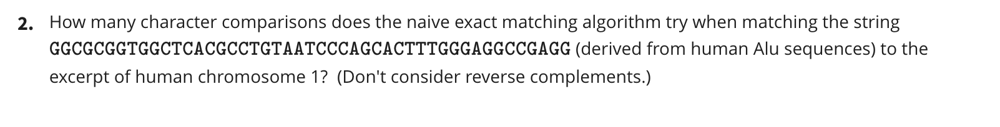

In [465]:
# naive exact matching algorithm
# Returns a list of occurrences (offset)
def naive_char_comparision(p, t):
    """
    p : pattern
    t : text, sequence, or genome
    """
    occurrences= []
    char_comparision = 0
    for i in range(len(t) - len(p) + 1):  # loop over alignments
        match = True
        for j in range(len(p)):  # loop over characters
            if t[i+j] != p[j]:  # compare characters
                match = False
                char_comparision += 2
                break
        if match:
            occurrences.append(i)  # all chars matched; record
    return occurrences, char_comparision

In [506]:
p = 'GGCGCGGTGGCTCACGCCTGTAATCCCAGCACTTTGGGAGGCCGAGG'
# list(filter(None,[naive(p, seq) for seq in seqs] ))
occurrences, alignments, comparisons = naive(p, chromosome1)

list(zip(['occurrences:', 'alignments:', 'comparisons:'], 
               [occurrences, alignments, comparisons]))

[('occurrences:', [56922]), ('alignments:', 799954), ('comparisons:', 984143)]

---

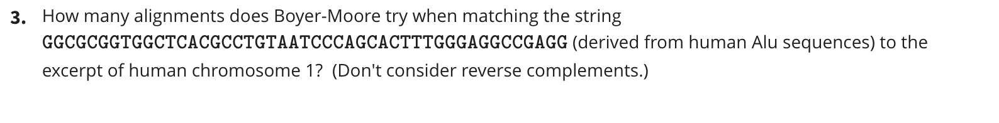

In [500]:
p = 'GGCGCGGTGGCTCACGCCTGTAATCCCAGCACTTTGGGAGGCCGAGG'
p_bm = BoyerMoore(p)
# p_bm.match_skip()
# list(filter(None,[boyer_moore(p, p_bm, seq) for seq in seqs]))

t = chromosome1
# p_bm = BoyerMoore(p, lowercase_alphabet)
occurrences, num_alignments, num_character_comparisons = boyer_moore_with_counts(p, p_bm, t)
list(zip(['occurrences:', 'num_alignments:', 'num_character_comparisons:'], 
               [occurrences, num_alignments, num_character_comparisons]))

[('occurrences:', [56922]),
 ('num_alignments:', 127974),
 ('num_character_comparisons:', 165191)]

---

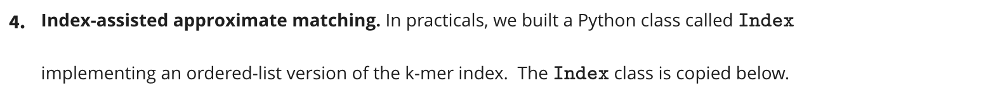

In [412]:
class Index(object):
    def __init__(self, t, k):
        ''' Create index from all substrings of size 'length' '''
        self.k = k  # k-mer length (k)
        self.index = []
        for i in range(len(t) - k + 1):  # for each k-mer
            self.index.append((t[i:i+k], i))  # add (k-mer, offset) pair
        self.index.sort()  # alphabetize by k-mer
    
    def query(self, p):
        ''' Return index hits for first k-mer of P '''
        kmer = p[:self.k]  # query with first k-mer
        i = bisect.bisect_left(self.index, (kmer, -1))  # binary search
        hits = []
        while i < len(self.index):  # collect matching index entries
            if self.index[i][0] != kmer:
                break
            hits.append(self.index[i][1])
            i += 1
        return hits

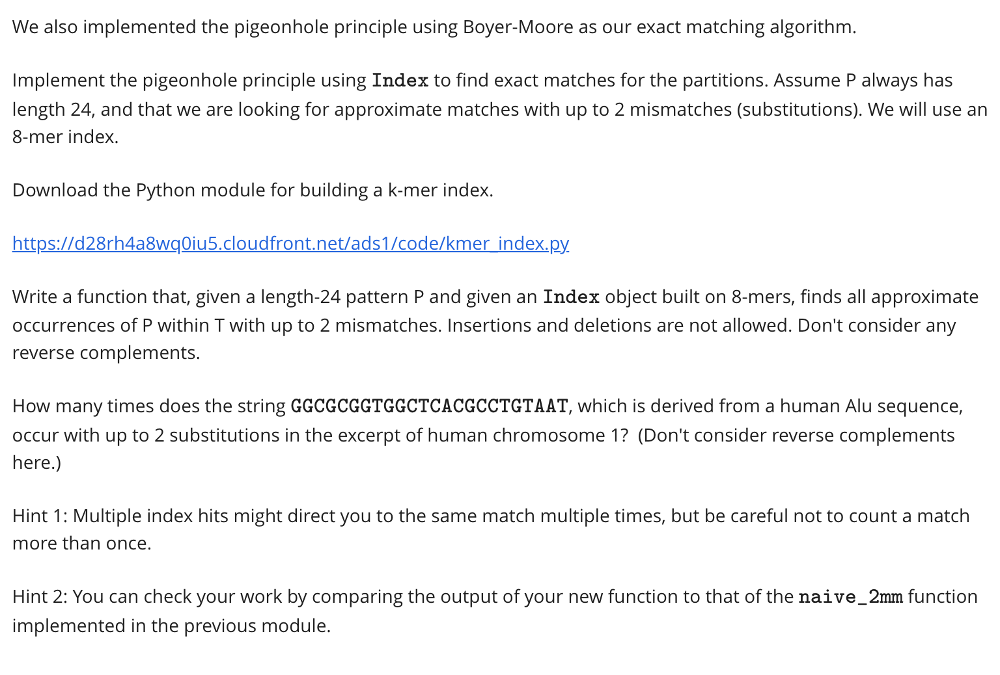

In [502]:
#!/usr/bin/env python

"""kmer_index.py: A k-mer index for indexing a text."""

__author__ = "Ben Langmead"

import bisect


class Index(object):
    """ Holds a substring index for a text T """

    def __init__(self, t, k):
        """ Create index from all substrings of t of length k """
        self.k = k  # k-mer length (k)
        self.index = []
        for i in range(len(t) - k + 1):  # for each k-mer
            self.index.append((t[i:i+k], i))  # add (k-mer, offset) pair
        self.index.sort()  # alphabetize by k-mer

    def query(self, p):
        """ Return index hits for first k-mer of p """
        kmer = p[:self.k]  # query with first k-mer
        i = bisect.bisect_left(self.index, (kmer, -1))  # binary search
        hits = []
        while i < len(self.index):  # collect matching index entries
            if self.index[i][0] != kmer:
                break
            hits.append(self.index[i][1])
            i += 1
        return hits


In [551]:
def queryIndex(p, t, index):
    k = index.k
    offsets = []
    for i in index.query(p):
        if (p[k:] == t[i+k:i+len(p)]):
            offsets.append(i)
    return offsets

## Example 1

In [554]:
t = 'GCTACGATCTAGAATCTA'
p = 'TCTA'

index = Index(t, 2)
ans = queryIndex(p, t, index)
print(ans)

print(t[7:7+len(p)] , t[14:14+len(p)])

[7, 14]
TCTA TCTA


In [535]:
#
# partial matching algroithm implementation using an exact matching algorithm (Indexing)
# combined with the pigeon hole principle to allow up to k mismatches of pattern in text
#
def approximate_match_index(p, t, k):
    """
    Approximate match index
    INPUTS: p=pattern, t=text/genome, k=kmers number 
    """
    segment_length = round(len(p) // (k+1))
    hits = 0
    all_matches = set()
    index = Index(t, 8) # built on 8-mers
    for i in range(k+1):
        start = i * segment_length
        end = min((i+1) * segment_length, len(p))
        matches = index.query(p[start:end])
        hits += len(matches)
        for m in matches:
            text_offset = m - start
            if text_offset < 0 or (text_offset + len(p)) > len(t):
                continue
            mismatches = 0
            for j in range(0, start):
                if not p[j] == t[text_offset + j]:
                    mismatches += 1
                    if mismatches > k:
                        break
            for j in range(end, len(p)):
                if not p[j] == t[text_offset + j]:
                    mismatches += 1
                    if mismatches > k:
                        break
            if mismatches <= k:
                all_matches.add(text_offset)
    return list(all_matches), hits

In [555]:
p = 'GGCGCGGTGGCTCACGCCTGTAAT'
t = chromosome1

all_match_list, hits = approximate_match_index(p, t, k = 2)
# list(zip(['occurrences:', 'num_alignments:', 'num_character_comparisons:'], 
#                [occurrences, num_alignments, num_character_comparisons]))

In [558]:
print(list(zip(['occurrences:', 'hits:', 'all_match_list:'], 
               [len(all_match_list), hits, all_match_list])))
print('\n')
print('occurrences:',len(all_match_list))

[('occurrences:', 19), ('hits:', 90), ('all_match_list:', [273669, 681737, 717706, 262042, 635931, 84641, 160162, 724927, 657496, 160729, 56922, 191452, 551134, 747359, 421221, 147558, 364263, 465647, 429299])]


occurrences: 19


---

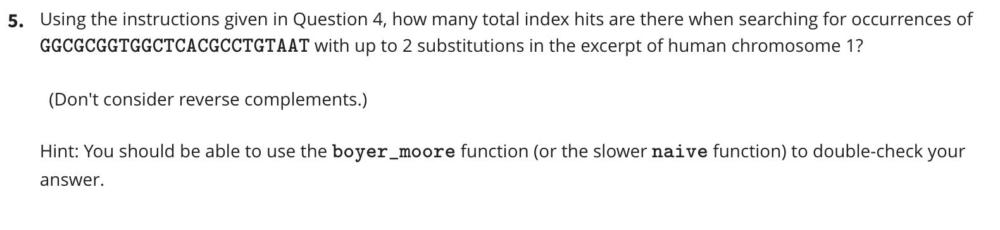

In [559]:
print('hits:',hits)

hits: 90


---

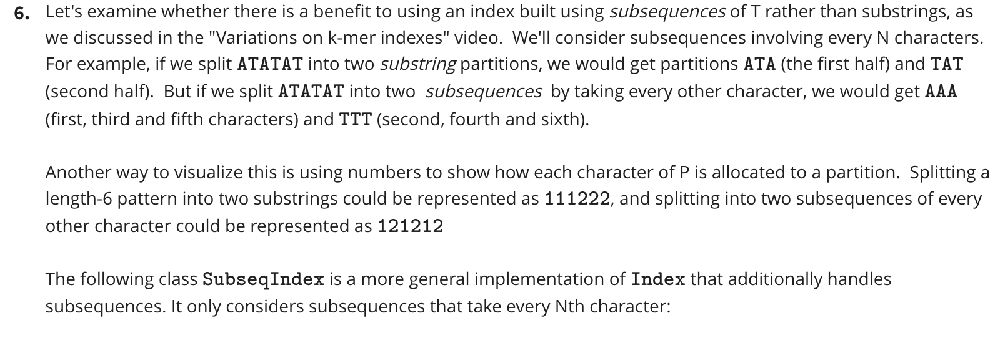

In [564]:
import bisect
   
class SubseqIndex(object):
    """ Holds a subsequence index for a text T """
    
    def __init__(self, t, k, ival):
        """ Create index from all subsequences consisting of k characters
            spaced ival positions apart.  E.g., SubseqIndex("ATAT", 2, 2)
            extracts ("AA", 0) and ("TT", 1). """
        self.k = k  # num characters per subsequence extracted
        self.ival = ival  # space between them; 1=adjacent, 2=every other, etc
        self.index = []
        self.span = 1 + ival * (k - 1)
        for i in range(len(t) - self.span + 1):  # for each subseq
            self.index.append((t[i:i+self.span:ival], i))  # add (subseq, offset)
        self.index.sort()  # alphabetize by subseq
    
    def query(self, p):
        """ Return index hits for first subseq of p """
        subseq = p[:self.span:self.ival]  # query with first subseq
        i = bisect.bisect_left(self.index, (subseq, -1))  # binary search
        hits = []
        while i < len(self.index):  # collect matching index entries
            if self.index[i][0] != subseq:
                break
            hits.append(self.index[i][1])
            i += 1
        return hits


# Example 1:

In [591]:
# For example, if we do:

ind = SubseqIndex('ATATAT', 3, 2)
print(ind.index)

# And if we query this index:

p = 'TTATAT'
print(ind.query(p[0:]))

# because the subsequence \verb|TAA|TAA is not in the index. But if we query with the second subsequence:
print(ind.query(p[1:]))

[('AAA', 0), ('TTT', 1)]
[]
[1]


## Example 2

In [596]:
t = 'to-morrow and to-morrow and to-morrow creeps in this petty pace'
p = 'to-morrow and to-morrow '
k = 3
subseq_ind = SubseqIndex(t, k, 2)
subseq_ind_query = subseq_ind.query(p)
print('subseq_ind.query:', subseq_ind_query)
print ('Text:  %s' % t)
for i in subseq_ind_query:
    print('Match: %s%s' % ('.'*i, t[i:i+k]))

# occurrences, num_index_hits = query_subseq(p, t, subseq_ind)
# print(occurrences)
# print(num_index_hits)



subseq_ind.query: [0, 14, 28]
Text:  to-morrow and to-morrow and to-morrow creeps in this petty pace
Match: to-
Match: ..............to-
Match: ............................to-


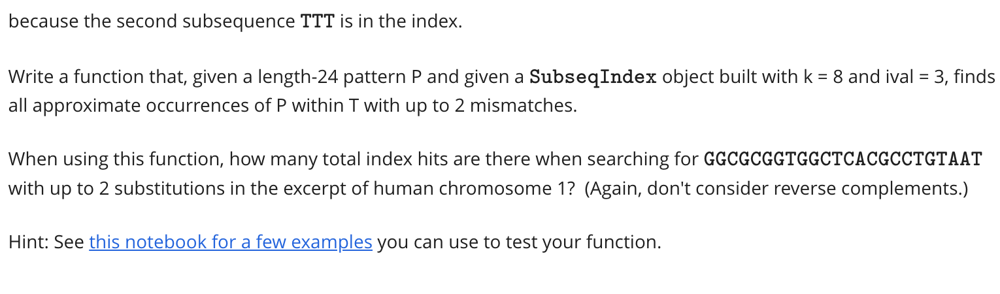

In [597]:
#
# partial matching algroithm implementation using an exact matching algorithm (Subsequence Indexing)
# combined with the pigeon hole principle to allow up to k mismatches of pattern in text
#
# note: in this solution, the partitions overlap ( ie. every 3rd subsequence interval, 123123123 )
# compared to the previous solutions where each partition has a unique, non-overlapping start/end
# ( ie. every 3rd chunk, 111222333 )
#
def query_subseq(p, t, k):
    segment_length = round(len(p) // (k+1))
    hits = 0
    all_matches = set()
    index = SubseqIndex(t, 8, 3) # built on 8-mers and subsequence intervals of 3
    for start in range(k+1):
        matches = index.query(p[start:])
        hits += len(matches)
        for m in matches:
            text_offset = m - start
            if text_offset < 0 or (text_offset + len(p)) > len(t):
                continue
            mismatches = 0
            for j in range(0, len(p)):
                if not p[j] == t[text_offset + j]:
                    mismatches += 1
                    if mismatches > k:
                        break
            if mismatches <= k:
                all_matches.add(text_offset)
    return list(all_matches), hits

In [599]:
t = chromosome1
p = 'GGCGCGGTGGCTCACGCCTGTAAT'
k = 2
_, hits = approximate_match_subseq_index(p, t, k)
print(hits)

79


#  
#  
# ++++++++++++++++++++++++++++++++++++++++++++++++++++++
# WEEK 3 : Edit distance, assembly, overlaps
# ++++++++++++++++++++++++++++++++++++++++++++++++++++++

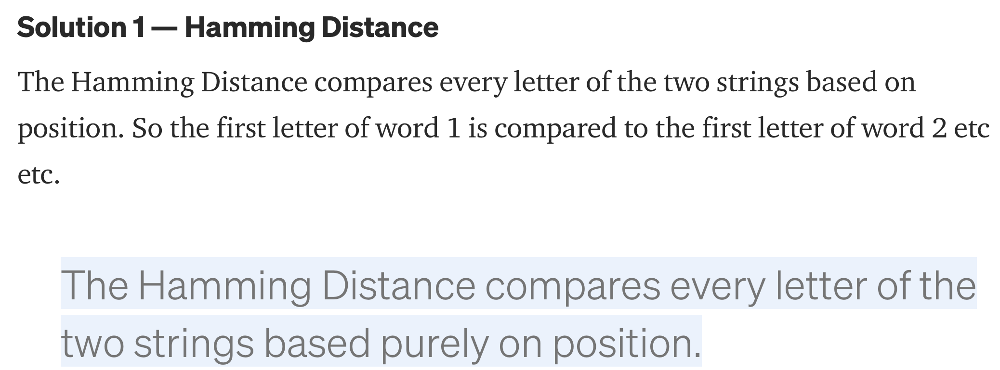
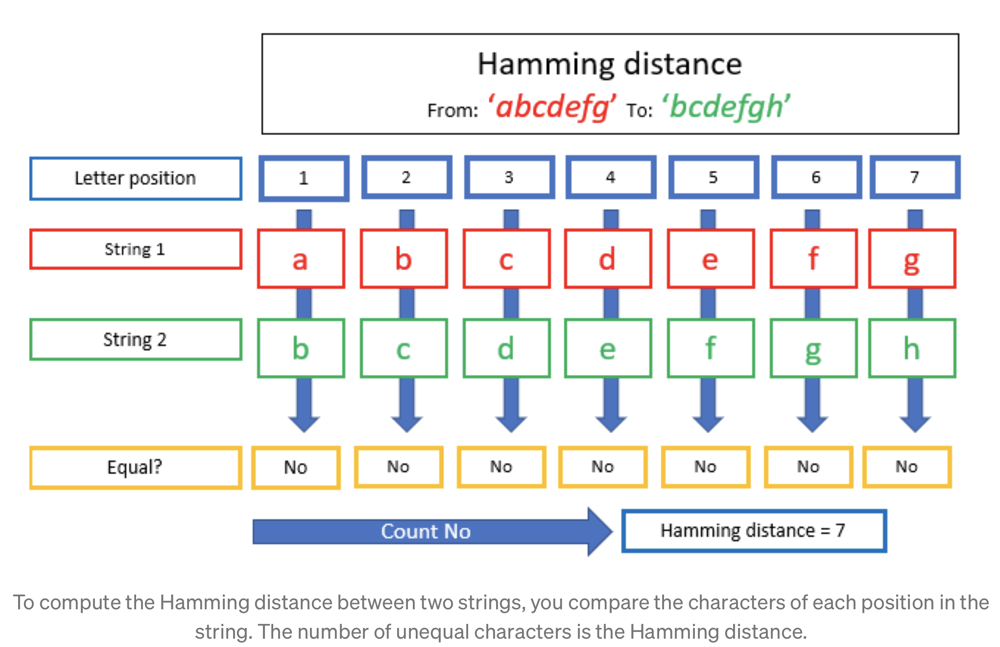

Ref: https://towardsdatascience.com/3-text-distances-that-every-data-scientist-should-know-7fcdf850e510

In [604]:
# Return the Hamming distance between string1 and string2.
# string1 and string2 should be the same length.
def hamming_distance(string1, string2): 
    # Start with a distance of zero, and count up
    distance = 0
    index =[]
    # Loop over the indices of the string
    L = len(string1)
    for i in range(L):
        # Add 1 to the distance if these two characters are not equal
        if string1[i] != string2[i]:
            distance += 1
            index.append(i)
    # Return the final count of differences
    return distance, index

## Example 1:

In [630]:
string1 = 'ABCS'
string2 = 'ABFG' 
distance, index = hamming_distance(string1, string2)

print(list(zip(['distance:', 'index:'],[distance, index])))


[('distance:', 2), ('index:', [2, 3])]


---

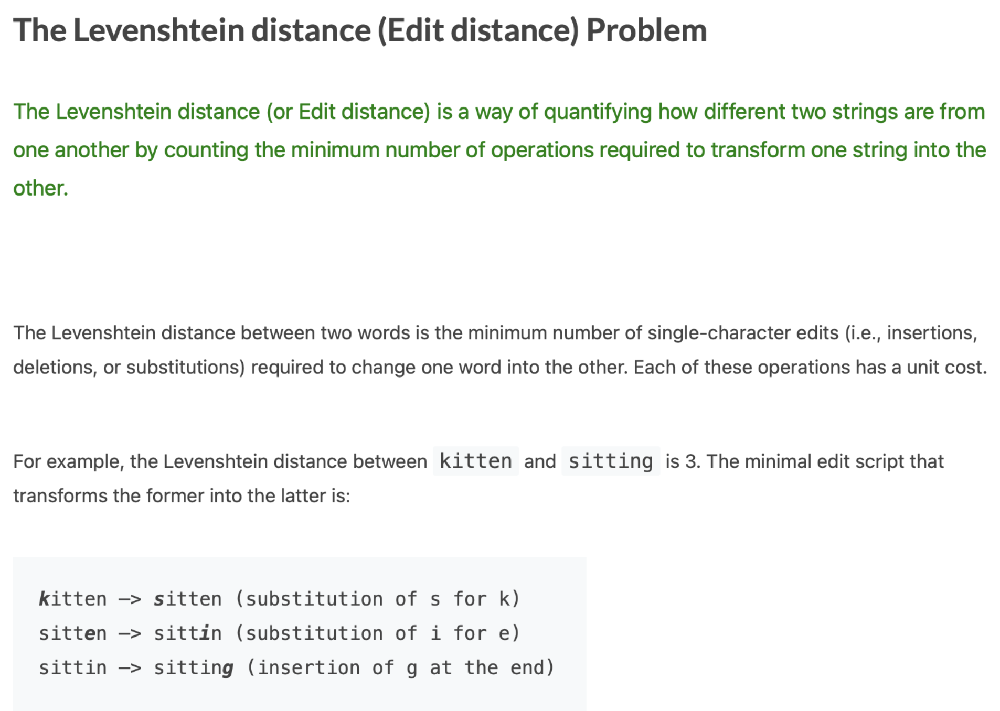

Ref: https://www.techiedelight.com/levenshtein-distance-edit-distance-problem/

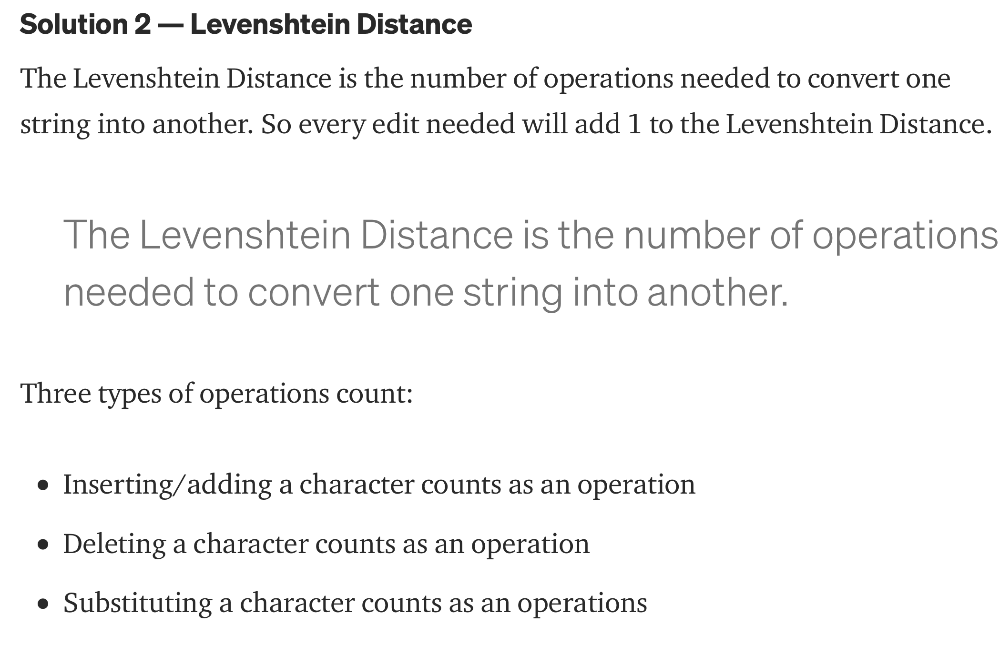
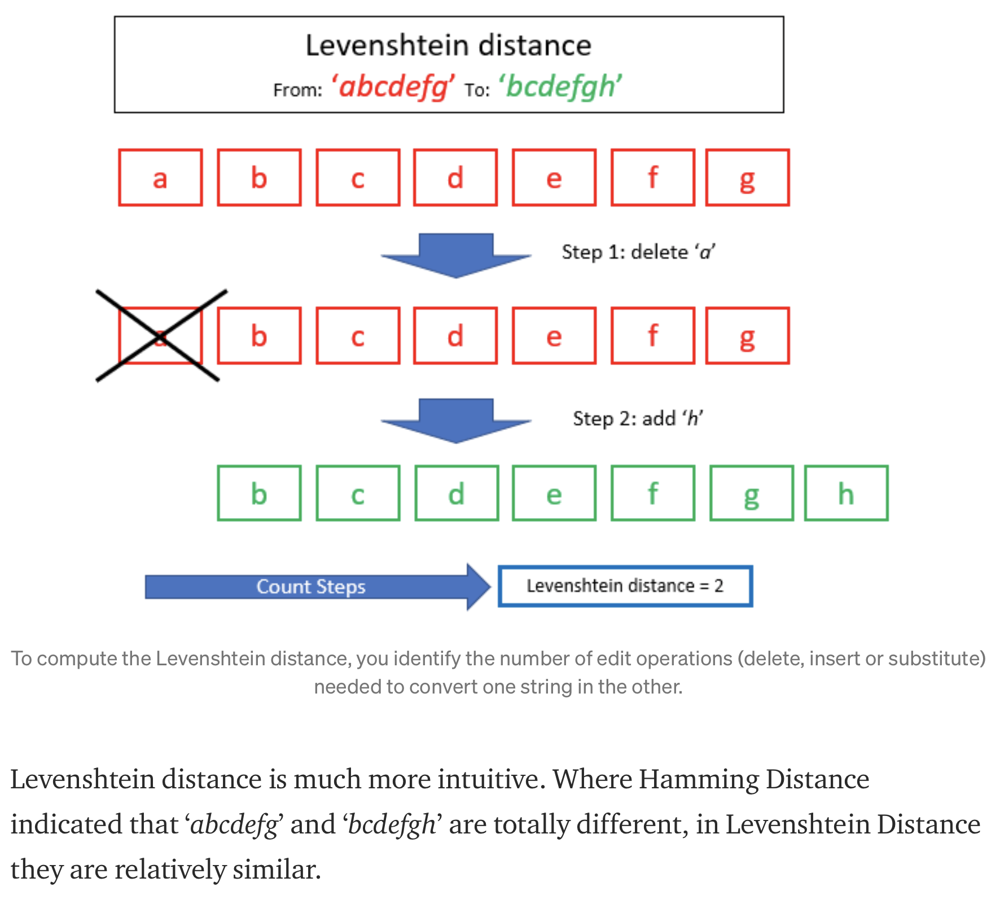

Ref: https://towardsdatascience.com/3-text-distances-that-every-data-scientist-should-know-7fcdf850e510

In [631]:
def editDistance (x,y):
    D = []
    for i in range(len(x)+1):
        D.append([0]*(len(y)+1))
        
    for i in range(len(x)+1):
        D[i][0] = i
    for i in range(len(y)+1):
        D[0][i] = i
    
    for i in range(1, len(x)+1):
        for j in range(1, len(y)+1):
            distHor = D[i][j-1] + 1
            distVer = D[i-1][j] + 1
            if x[i-1] == y[j-1]:
                distDiag = D[i-1][j-1]
            else:
                distDiag = D[i-1][j-1] + 1
                
            D[i][j] = min(distHor, distVer, distDiag)
            
    return D[-1][-1]

## Example 1:

In [639]:
string1 = 'ABCS'
string2 = 'ABFG' 
distance = editDistance(string1, string2)

print(list(zip(['Edit Distance:'],[distance]))[0])


('Edit Distance:', 2)


## Example 2:

In [641]:
x = 'shake spea'
y = 'Shakespear'

distance = editDistance(x, y)

print(list(zip(['Edit Distance:'],[distance]))[0])


('Edit Distance:', 3)


---

#  
# The Edit Distance Table
# 

## Minimum Edit distance from `INTENTION` to `EXECUTION`

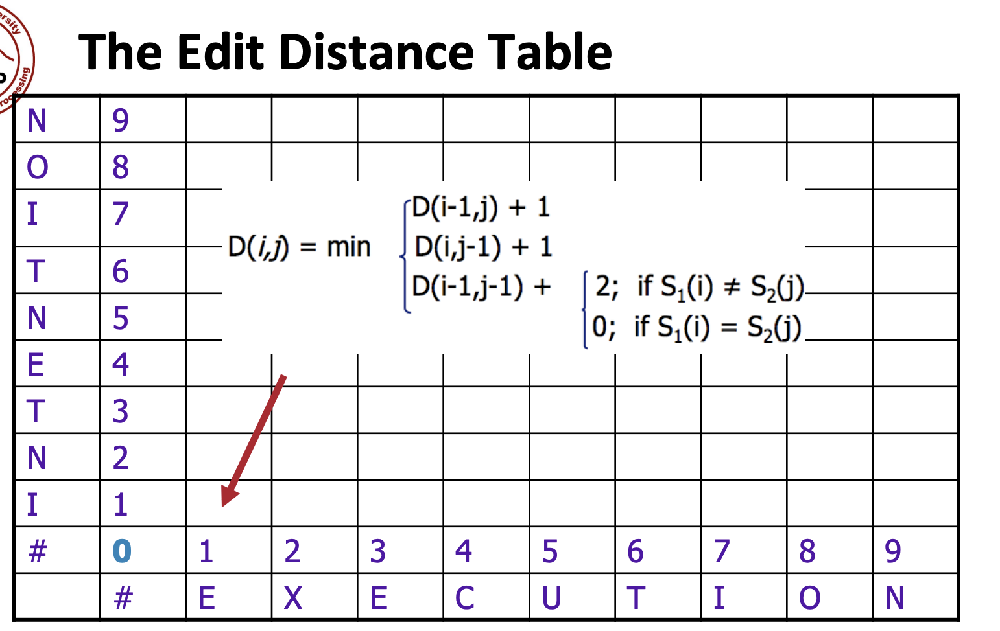
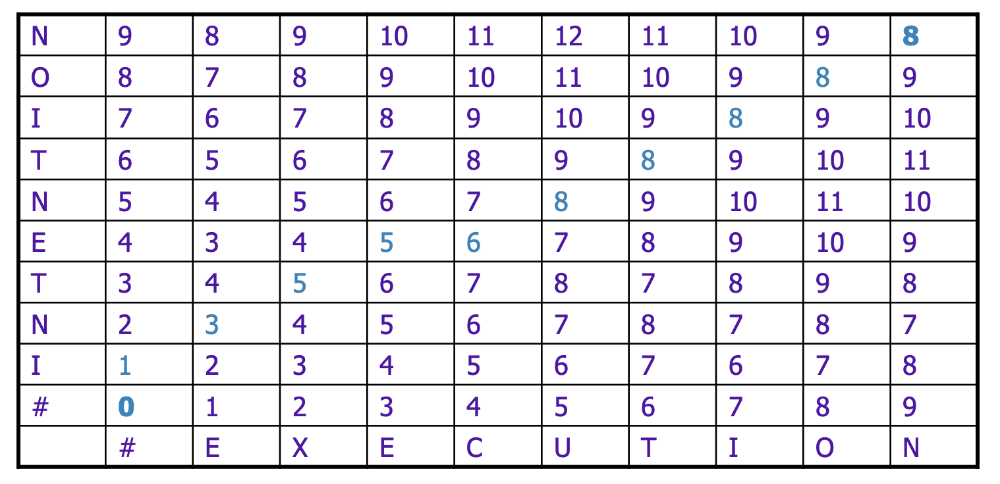

Ref: https://web.stanford.edu/class/cs124/lec/med.pdf

---

# Global and local alignments

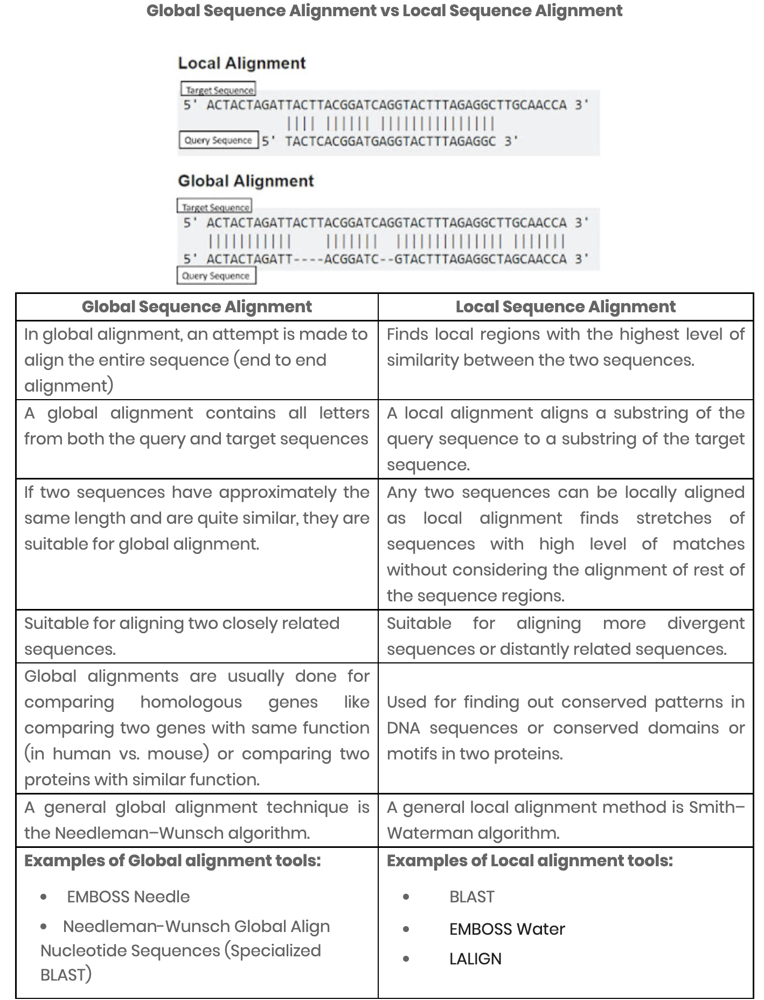

Ref: https://www.majordifferences.com/2016/05/difference-between-global-and-local.html

# Python Script for Global Alignment

In [648]:
class ScoreParams:
	'''
	Define scores for each parameter
    Author: https://github.com/risg99/Local-And-Global-Sequence-Alignment-Python-Scratch
	'''
	def __init__(self,gap,match,mismatch):
		self.gap = gap
		self.match = match
		self.mismatch = mismatch

	def misMatchChar(self,x,y):
		if x != y:
			return self.mismatch
		else:
			return self.match

def getMatrix(sizeX,sizeY,gap):
	'''
	Create an initial matrix of zeros, such that its len(x) x len(y)
	'''
	matrix = []
	for i in range(len(sizeX)+1):
		subMatrix = []
		for j in range(len(sizeY)+1):
			subMatrix.append(0)
		matrix.append(subMatrix)

	# Initializing the first row and first column with the gap values
	for j in range(1,len(sizeY)+1):
		matrix[0][j] = j*gap
	for i in range(1,len(sizeX)+1):
		matrix[i][0] = i*gap
	return matrix

def getTraceBackMatrix(sizeX,sizeY):
	'''
	Create an initial matrix of zeros, such that its len(x) x len(y)
	'''
	matrix = []
	for i in range(len(sizeX)+1):
		subMatrix = []
		for j in range(len(sizeY)+1):
			subMatrix.append('0')
		matrix.append(subMatrix)

	# Initializing the first row and first column with the up or left values
	for j in range(1,len(sizeY)+1):
		matrix[0][j] = 'left'
	for i in range(1,len(sizeX)+1):
		matrix[i][0] = 'up'
	matrix[0][0] = 'done'
	return matrix


def globalAlign(x,y,score):
	'''
	Fill in the matrix with alignment scores
	'''
	matrix = getMatrix(x,y,score.gap)
	traceBack = getTraceBackMatrix(x,y)

	for i in range(1,len(x)+1):
		for j in range(1,len(y)+1):
			left = matrix[i][j-1] + score.gap
			up = matrix[i-1][j] + score.gap
			diag = matrix[i-1][j-1] + score.misMatchChar(x[i-1],y[j-1])
			matrix[i][j] = max(left,up,diag)
			if matrix[i][j] == left:
				traceBack[i][j] = 'left'
			elif matrix[i][j] == up:
				traceBack[i][j] = 'up'
			else:
				traceBack[i][j] = 'diag'
	return matrix,traceBack

def getAlignedSequences(x,y,matrix,traceBack):
	'''
	Obtain x and y globally aligned sequence arrays using the bottom-up approach
	'''
	xSeq = []
	ySeq = []
	i = len(x)
	j = len(y)
	while(i > 0 or j > 0):
		if traceBack[i][j] == 'diag':
			# Diag is scored when x[i-1] == y[j-1]
			xSeq.append(x[i-1])
			ySeq.append(y[j-1])
			i = i-1
			j = j-1
		elif traceBack[i][j] == 'left':
			# Left holds true when '-' is added from x string and y[j-1] from y string
			xSeq.append('-')
			ySeq.append(y[j-1])
			j = j-1
		elif traceBack[i][j] == 'up':
			# Up holds true when '-' is added from y string and x[j-1] from x string
			xSeq.append(x[i-1])
			ySeq.append('-')
			i = i-1
		elif traceBack[i][j] == 'done':
			# Break condition when we reach the [0,0] cell of traceback matrix
			break
	return xSeq,ySeq

def printMatrix(matrix):
	'''
	Create a custom function to print the matrix
	'''
	for i in range(len(matrix)):
		print(matrix[i])
	print()

'''
Driver Code:
'''
x = 'sbestoftimesn'
y = 'soften'
print('Input sequences are: ')
print(x)
print(y)
print()
score = ScoreParams(-2,1,-1)
matrix,traceBack = globalAlign(x,y,score)

print('Printing the score matrix:')
printMatrix(matrix)

print('Printing the trace back matrix:')
printMatrix(traceBack)

xSeq,ySeq = getAlignedSequences(x,y,matrix,traceBack)

print('The globally aligned sequences are:')
print(*xSeq[::-1])
print(*ySeq[::-1])

Input sequences are: 
sbestoftimesn
soften

Printing the score matrix:
[0, -2, -4, -6, -8, -10, -12]
[-2, 1, -1, -3, -5, -7, -9]
[-4, -1, 0, -2, -4, -6, -8]
[-6, -3, -2, -1, -3, -3, -5]
[-8, -5, -4, -3, -2, -4, -4]
[-10, -7, -6, -5, -2, -3, -5]
[-12, -9, -6, -7, -4, -3, -4]
[-14, -11, -8, -5, -6, -5, -4]
[-16, -13, -10, -7, -4, -6, -6]
[-18, -15, -12, -9, -6, -5, -7]
[-20, -17, -14, -11, -8, -7, -6]
[-22, -19, -16, -13, -10, -7, -8]
[-24, -21, -18, -15, -12, -9, -8]
[-26, -23, -20, -17, -14, -11, -8]

Printing the trace back matrix:
['done', 'left', 'left', 'left', 'left', 'left', 'left']
['up', 'diag', 'left', 'left', 'left', 'left', 'left']
['up', 'up', 'diag', 'left', 'left', 'left', 'left']
['up', 'up', 'up', 'diag', 'left', 'diag', 'left']
['up', 'up', 'up', 'up', 'diag', 'left', 'diag']
['up', 'up', 'up', 'up', 'diag', 'diag', 'left']
['up', 'up', 'diag', 'up', 'up', 'diag', 'diag']
['up', 'up', 'up', 'diag', 'up', 'up', 'diag']
['up', 'up', 'up', 'up', 'diag', 'left', 'up']
['up

# Python Script for Local Alignment

In [650]:
class ScoreParams:
	'''
	Define scores for each parameter
    Author: https://github.com/risg99/Local-And-Global-Sequence-Alignment-Python-Scratch    
	'''
	def __init__(self,gap,match,mismatch):
		self.gap = gap
		self.match = match
		self.mismatch = mismatch

def getMatrix(sizeX,sizeY):
	'''
	Create an empty matrix of zeros, such that its len(y) x len(x)
	'''
	matrix = []
	for i in range(len(sizeY)+1):
		subMatrix = []
		for j in range(len(sizeX)+1):
			subMatrix.append(0)
		matrix.append(subMatrix)
	return matrix

def localAlign(x,y,score):
	'''
	Fill in the matrix with alignment scores and obtain the best score and position
	'''
	matrix = getMatrix(x,y)
	best = 0
	optLoc = (0,0)

	for i in range(1,len(y)+1):
		for j in range(1,len(x)+1):
			matrix[i][j] = max(
				matrix[i][j-1] + score.gap,
				matrix[i-1][j] + score.gap,
				matrix[i-1][j-1] + (score.match if x[j-1] == y[i-1] else score.mismatch),
				0
				)

			if matrix[i][j] >= best:
				best = matrix[i][j]
				optLoc = (i,j)

	return best, optLoc, matrix

def printMatrix(matrix):
	'''
	Create a custom function to print the matrix
	'''
	for i in range(len(matrix)):
		print(matrix[i])
	print()

def getSequence(x,best,optLoc,matrix):
	'''
	Obtaining the locally aligned sequence using matrix
	'''
	seq = ''
	i = optLoc[0]
	j = optLoc[1]

	while(i > 0 or j > 0):

		diag = matrix[i-1][j-1]
		up = matrix[i-1][j]
		left = matrix[i][j-1]

		if min(diag,left,up) == diag:
			# Break condition when diag score is the maximum
			break
		else:
			# Adding to the sequence
			i = i - 1
			j = j - 1
			seq += x[j]
	return seq[::-1]

## Example 1:

In [651]:
x = 'sbestoftimesn'
y = 'soften'
print('Input sequences are: ')
print(x)
print(y)
print()
score = ScoreParams(-7,10,-5)
best, optLoc, matrix = localAlign(x,y,score)

print('Score matrix:')
printMatrix(matrix)

print('The best score obtained is: '+str(best))
print('The best locally aligned sequence is from index '+str(optLoc[0])+' to index '+str(optLoc[1])+' of the string: '+x)
print('The sequence thus obtained: ' + x[optLoc[0]:optLoc[1]])

alignedSequence = getSequence(x,best,optLoc,matrix)
print('The sequence obtained via traceback is: '+ str(alignedSequence))

Input sequences are: 
sbestoftimesn
soften

Score matrix:
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 10, 3, 0, 10, 3, 0, 0, 0, 0, 0, 0, 10, 3]
[0, 3, 5, 0, 3, 5, 13, 6, 0, 0, 0, 0, 3, 5]
[0, 0, 0, 0, 0, 0, 6, 23, 16, 9, 2, 0, 0, 0]
[0, 0, 0, 0, 0, 10, 3, 16, 33, 26, 19, 12, 5, 0]
[0, 0, 0, 10, 3, 3, 5, 9, 26, 28, 21, 29, 22, 15]
[0, 0, 0, 3, 5, 0, 0, 2, 19, 21, 23, 22, 24, 32]

The best score obtained is: 33
The best locally aligned sequence is from index 4 to index 8 of the string: sbestoftimesn
The sequence thus obtained: toft
The sequence obtained via traceback is: oft


---

In [660]:
alphabet = ['A','C','G','T']
score = [[0, 4, 2, 4, 8], \
         [4, 0, 4, 2, 8],
         [2, 4, 0, 4, 8],
         [4, 2, 4, 0, 8],
         [8, 8, 8, 8, 8]]

def globalAlignment (x,y):
    D = []
    for i in range(len(x)+1):
        D.append([0]*(len(y)+1))
        
    for i in range(1, len(x)+1):
        D[i][0] = D[i-1][0] + score[alphabet.index(x[i-1])][-1]
    for i in range(1, len(y)+1):
        D[0][i] = D[0][i-1]  + score[-1][alphabet.index(y[i-1])]
    
    for i in range(1, len(x)+1):
        for j in range(1, len(y)+1):
            distHor = D[i][j-1] + score[-1][alphabet.index(y[j-1])]
            distVer = D[i-1][j] + score[alphabet.index(x[i-1])][-1]
            if x[i-1] == y[j-1]:
                distDiag = D[i-1][j-1]
            else:
                distDiag = D[i-1][j-1] + score[alphabet.index(x[i-1])][alphabet.index(y[j-1])]
                
            D[i][j] = min(distHor, distVer, distDiag)
            
    return D[-1][-1]

# Example

In [661]:
x = 'TACCGCGGTT'
y = 'TACCGCGGATT'
globalAlignment(x,y)

8

---

# Law of Assembly

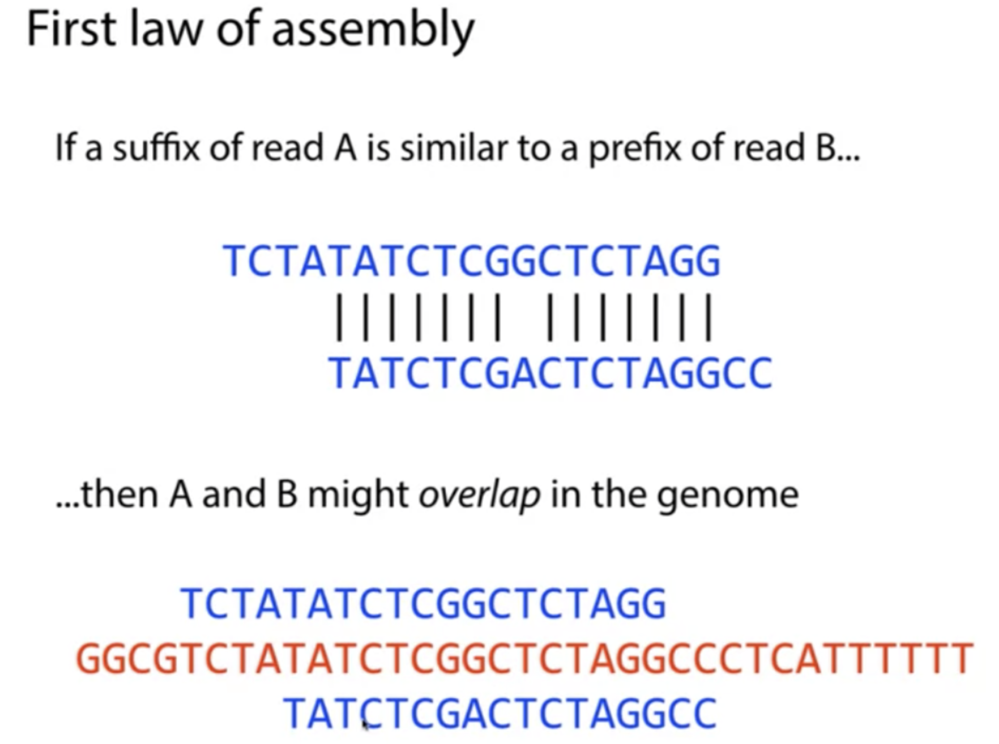

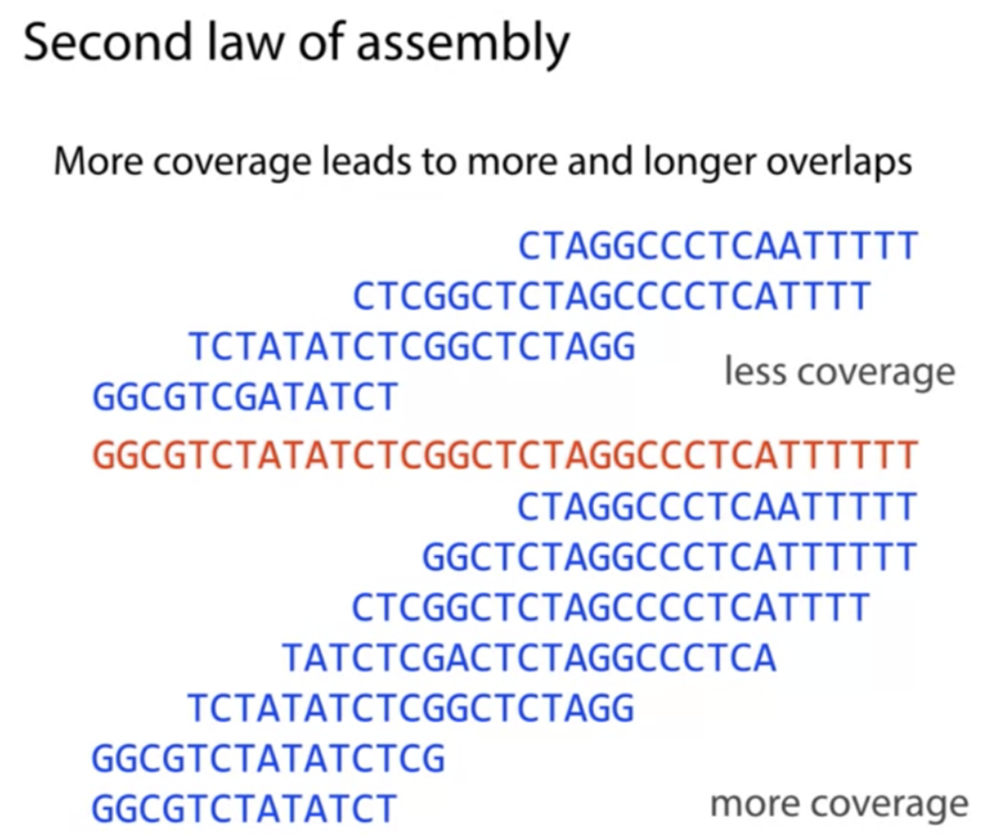

---

# Overlab Graph

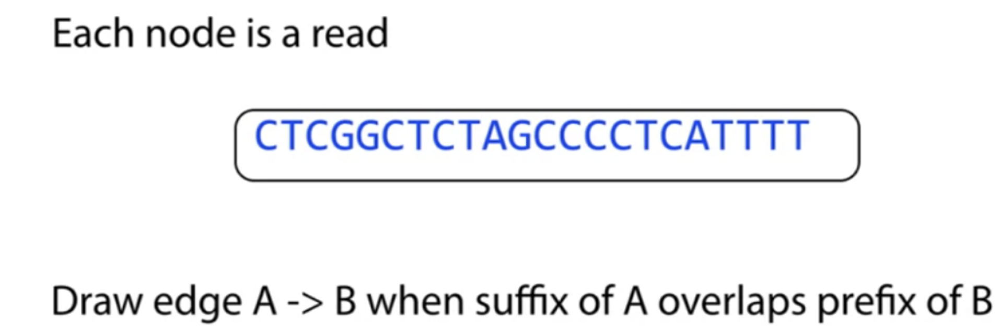

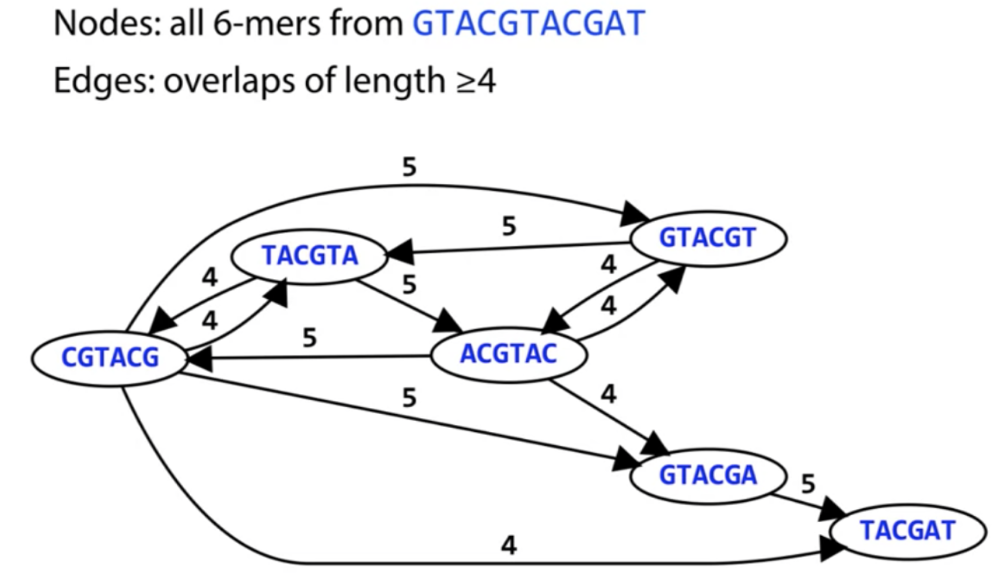

# 
# 
# WEEK 3: Programming Homework

In [738]:
def editDistance(x, y):
    # Create distance matrix
    D = []
    for i in range(len(x)+1):
        D.append([0]*(len(y)+1))
    # Initialize first row and column of matrix
    for i in range(len(x)+1):
        D[i][0] = i
    for i in range(len(y)+1):
        D[0][i] = i
    # Fill in the rest of the matrix
    for i in range(1, len(x)+1):
        for j in range(1, len(y)+1):
            distHor = D[i][j-1] + 1
            distVer = D[i-1][j] + 1
            if x[i-1] == y[j-1]:
                distDiag = D[i-1][j-1]
            else:
                distDiag = D[i-1][j-1] + 1
            D[i][j] = min(distHor, distVer, distDiag)
    # Edit distance is the value in the bottom right corner of the matrix
    return D[-1][-1]

In [759]:
def editDistanceNaive(A, B):
    def go(A, B, i, j):
        if i == 0: return j
        if j == 0: return i
        return min(
            go(A, B, i-1, j-1) + int(A[i-1] != B[j-1]),
            go(A, B, i, j-1) + 1,
            go(A, B, i-1, j) + 1,
        )
    return go(A, B, len(A), len(B))

def editDistanceMemo(A, B):
    def go(A, B, i, j, memo={}):
        key = str(i) + ',' + str(j)
        if memo.get(key): return memo[key]
        elif i == 0: memo[key] = j
        elif j == 0: memo[key] = i
        else:
            memo[key] = min(
                go(A, B, i-1, j-1, memo) + int(A[i-1] != B[j-1]),
                go(A, B, i, j-1, memo) + 1,
                go(A, B, i-1, j, memo) + 1,
            )
        return memo[key]
    return go(A, B, len(A), len(B))

def editDistanceDP(A, B):
    m, n = len(A), len(B)
    dp = [[0 for j in range(n+1)] for i in range(m+1)]
    for i in range(m+1): dp[i][0] = i
    for j in range(n+1): dp[0][j] = j
    for i in range(1, m+1):
        for j in range(1, n+1):
            dp[i][j] = min(
                dp[i-1][j-1] + int(A[i-1] != B[j-1]),
                dp[i-1][j] + 1,
                dp[i][j-1] + 1,
            )
    return dp[m][n]

In [760]:
def read_FAST_A(filename):
    genome = ''
    with open(filename, 'r') as f:
        for line in f:
            # ignore header line with genome information
            if not line[0] == '>':
                genome += line.rstrip()
    return genome

In [761]:
chromosm_GRCh38 = read_FAST_A('week3__Edit_distance_assembly_overlaps/chr1.GRCh38.excerpt.fasta')

In [762]:
# chromosm_GRCh38 = ''.join(chromosm_GRCh38)

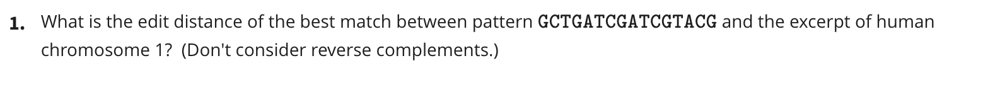


In [764]:
print(editDistanceDP("GCTGATCGATCGTACG", chromosm_GRCh38[0]))

15


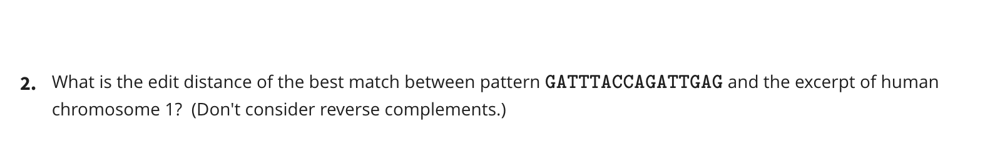

In [673]:
p = 'GATTTACCAGATTGAG'
editDistance(chromosm_GRCh38, p)

799984

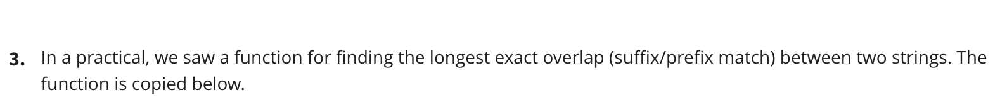

In [662]:
def overlap(a, b, min_length=3):
    """ Return length of longest suffix of 'a' matching
        a prefix of 'b' that is at least 'min_length'
        characters long.  If no such overlap exists,
        return 0. """
    start = 0  # start all the way at the left
    while True:
        start = a.find(b[:min_length], start)  # look for b's prefix in a
        if start == -1:  # no more occurrences to right
            return 0
        # found occurrence; check for full suffix/prefix match
        if b.startswith(a[start:]):
            return len(a)-start
        start += 1  # move just past previous match

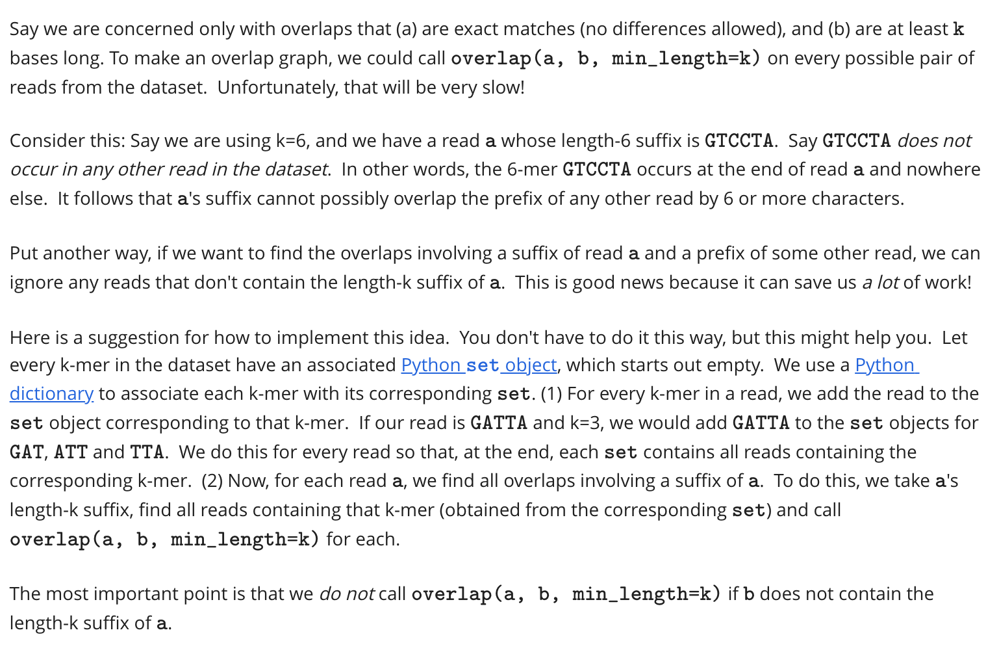
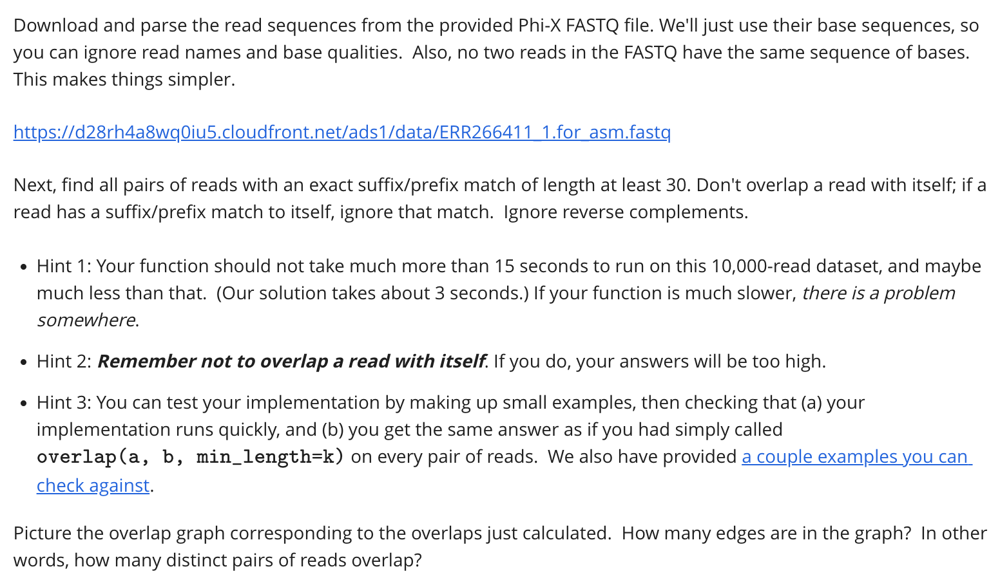

In [675]:
def overlap_all_pairs(reads, k, map={}):
    def get_kmers(read, k):
        res = set()
        for i in range(0, len(read)-k+1):
            res.add(read[i:i+k])
        return res
    for read in reads:
        kmers = get_kmers(read, k)
        for kmer in kmers:
            if not kmer in map.keys():
                map[kmer] = set()
            map[kmer].add(read)
    pairs = []
    for head in reads:
        kmer = head[-k:]
        candidates = map[kmer]
        for tail in candidates:
            if (not head == tail and overlap(head, tail, k)):
                pairs.append((head, tail))
    return pairs

In [686]:
def readFAST_Q(filename):
    sequences = []
    qualities = []
    with open(filename) as fh:
        while True:
            fh.readline()  # skip name line
            seq = fh.readline().rstrip()  # read base sequence
            fh.readline()  # skip placeholder line
            qual = fh.readline().rstrip() # base quality line
            if len(seq) == 0:
                break
            sequences.append(seq)
            qualities.append(qual)
    return sequences, qualities

In [688]:
reads, _ = readFAST_Q('week3__Edit_distance_assembly_overlaps/ERR266411_1.for_asm.fastq')


In [689]:
pairs = overlap_all_pairs(reads, 30)

In [690]:
print(len(pairs))

904746


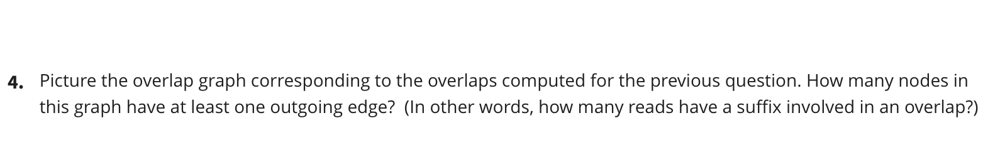

In [691]:
print(len(set(pair[0] for pair in pairs)))

7161


#  
#  
# ++++++++++++++++++++++++++++++++++++++++++++++++++++++
# WEEK 4 : Algorithms for assembly
# ++++++++++++++++++++++++++++++++++++++++++++++++++++++

# Algorithm 1:  brute force method of calculating the shortest common superstring

the shortest common superstring, so this is a string that contains all the input strings as substrings and there is no shorter string that does this, that contains all the input strings.

Note: brute force is NP-hard if an algorithm for solving it can be translated into one for solving any NP-problem (nondeterministic polynomial time) problem. NP-hard therefore means "at least as hard as any NP-problem," although it might, in fact, be harder.

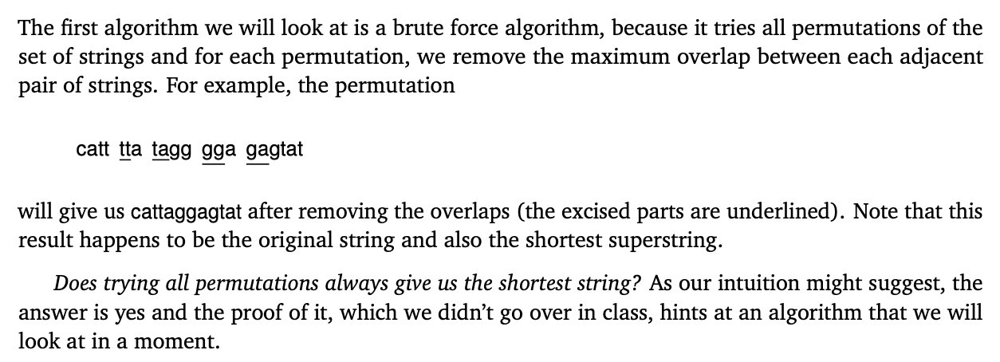

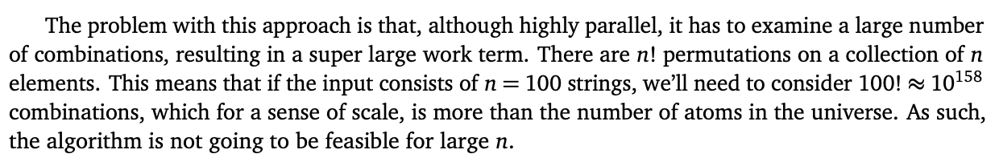
Ref: http://www.cs.cmu.edu/afs/cs/academic/class/15210-s12/www/lectures/lecture06.pdf

In [692]:
def overlap (a, b, min_length = 3):
    start = 0
    
    while True:
        start = a.find(b[:min_length], start)
        if start == -1:
            return 0
        if b.startswith(a[start:]):
            return len(a) - start
        start += 1
        
        

In [693]:
import itertools

def scs(ss):
    shortest_sup = None
    for ssperm in itertools.permutations(ss):
        sup = ssperm[0]
        for i in range(len(ss) - 1):
            olen = overlap(ssperm[i], ssperm[i+1], min_length=1)
            sup += ssperm[i+1][olen:]
        if shortest_sup is None or len(sup) < len(shortest_sup):
            shortest_sup = sup
    return shortest_sup

## Example 1:

In [696]:
ss = ['ABC', 'CDE', 'EEEF']
scs(ss) 

'ABCDEEEF'

# --------------------------------------------------------------------------------
# 
# 

# Algorithm 2: Greedy shortest common superstring

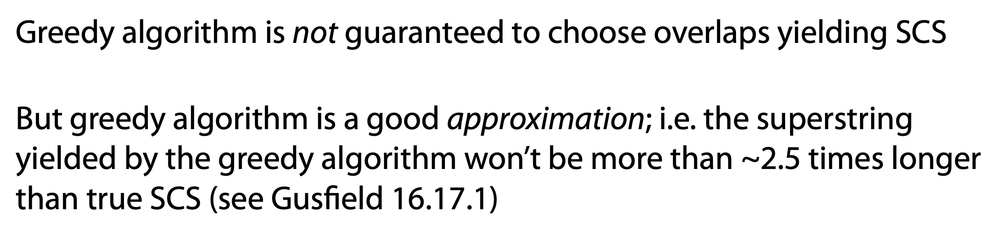

### Greedy explination using Overlap graph: 
> So remember that the nodes of the overlap graph correspond to reads and the edges of the overlap graph correspond to overlaps or suffix prefix matches between pairs of reads.

> Each edge here is labeled with a number that gets the length of the overlap The length of the suffix prefix match.

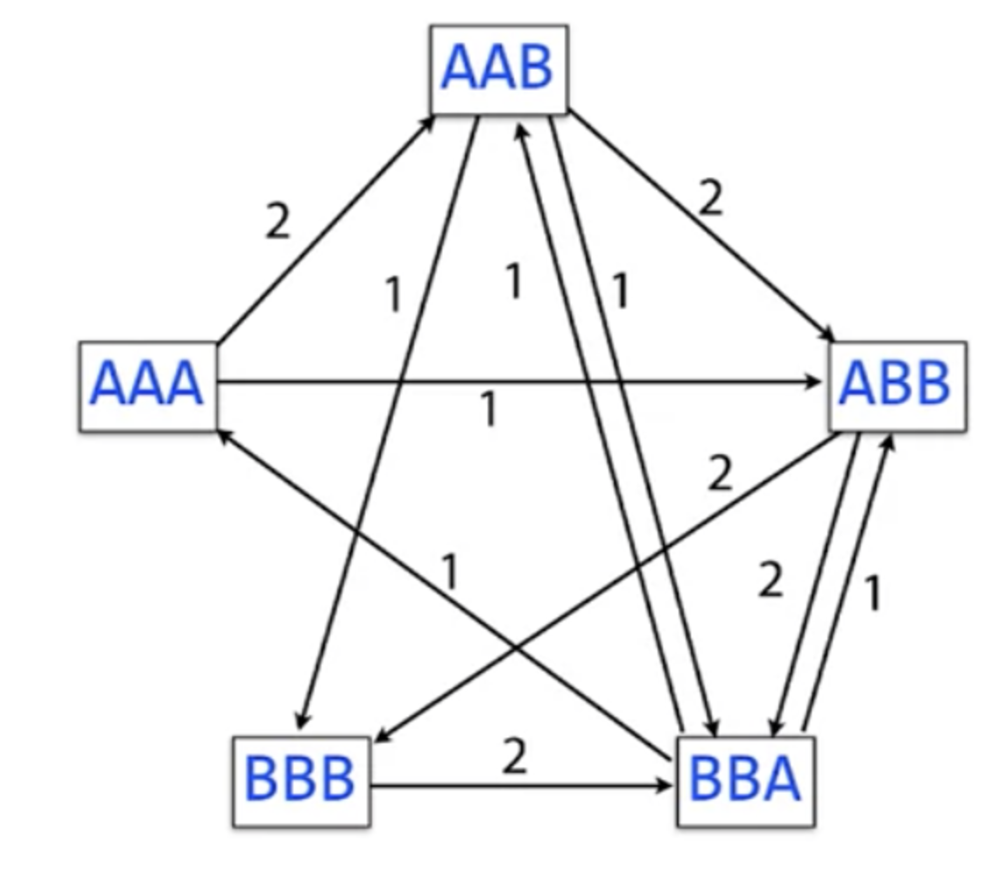
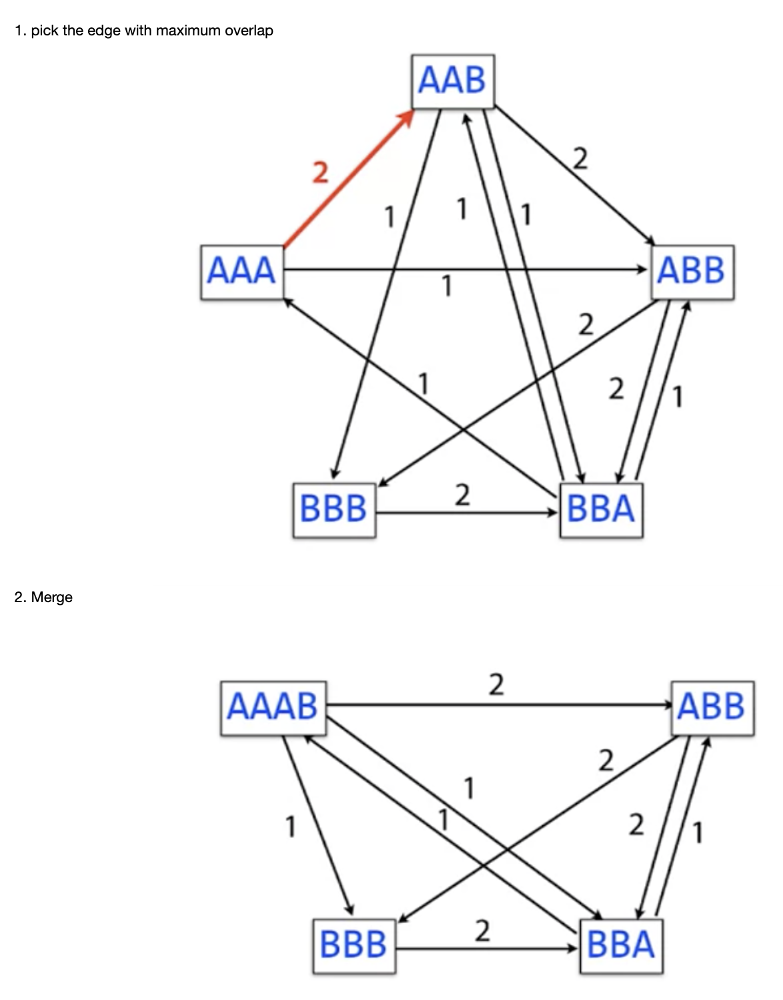
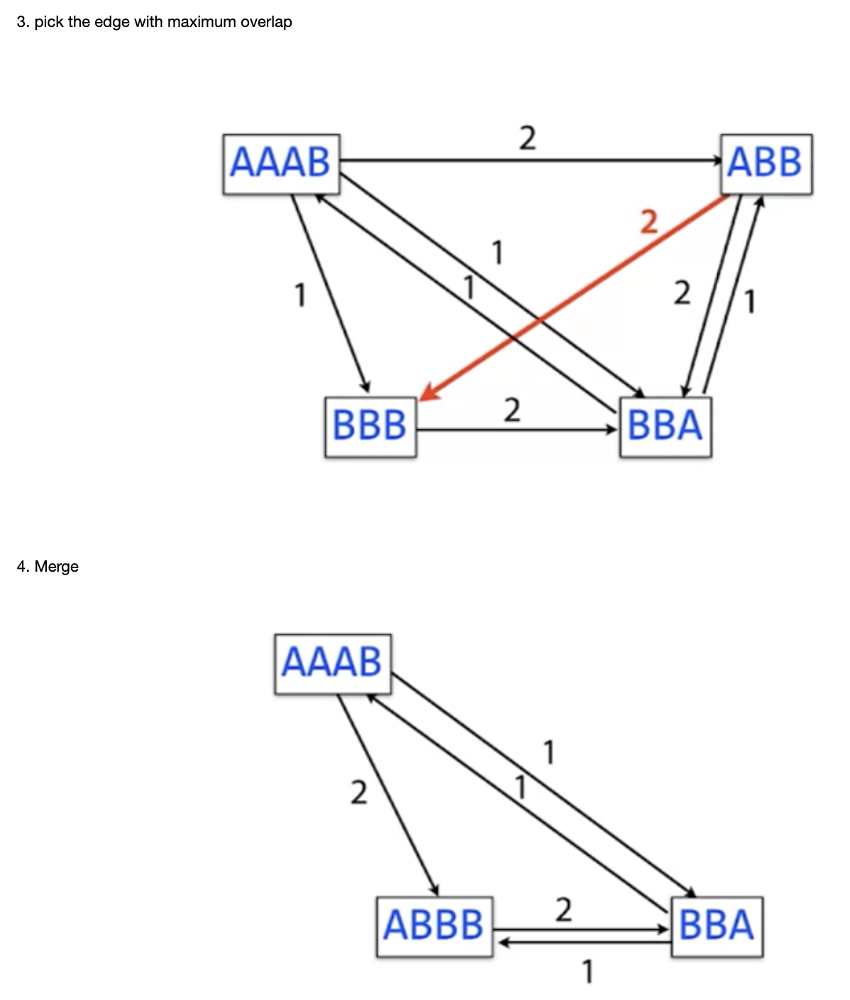
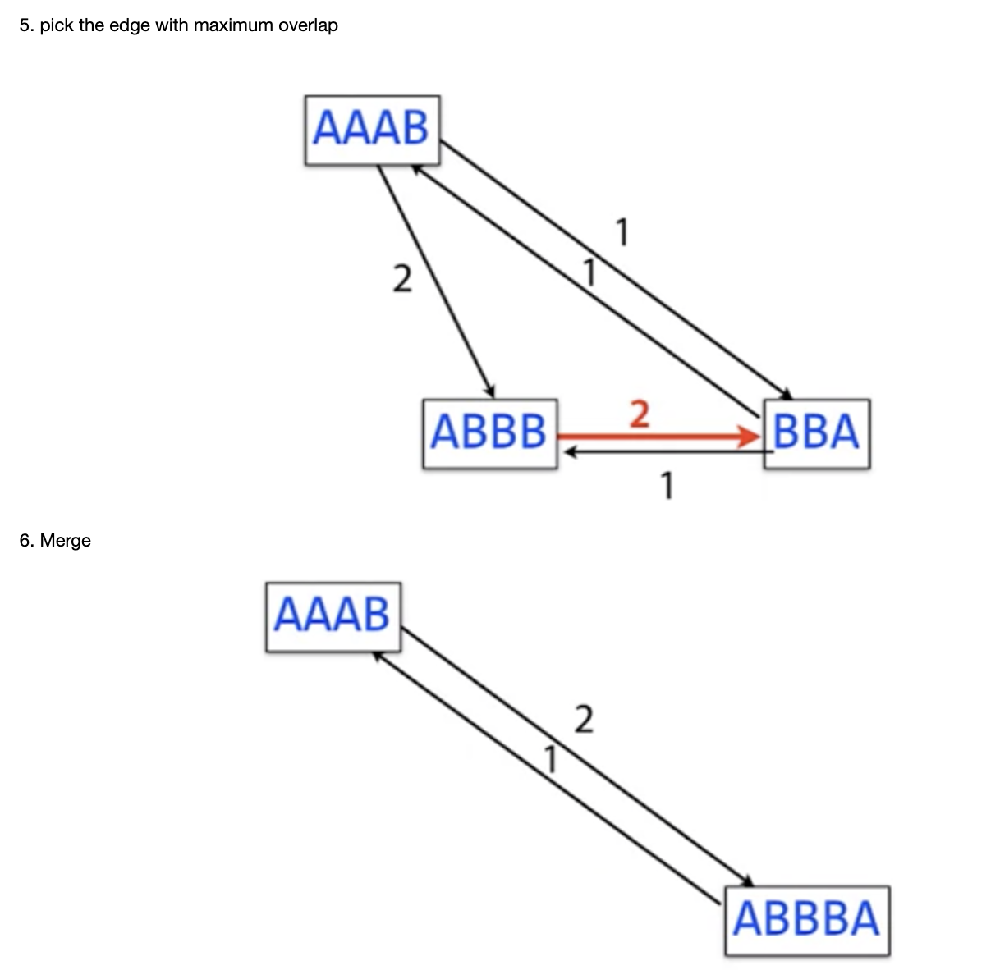
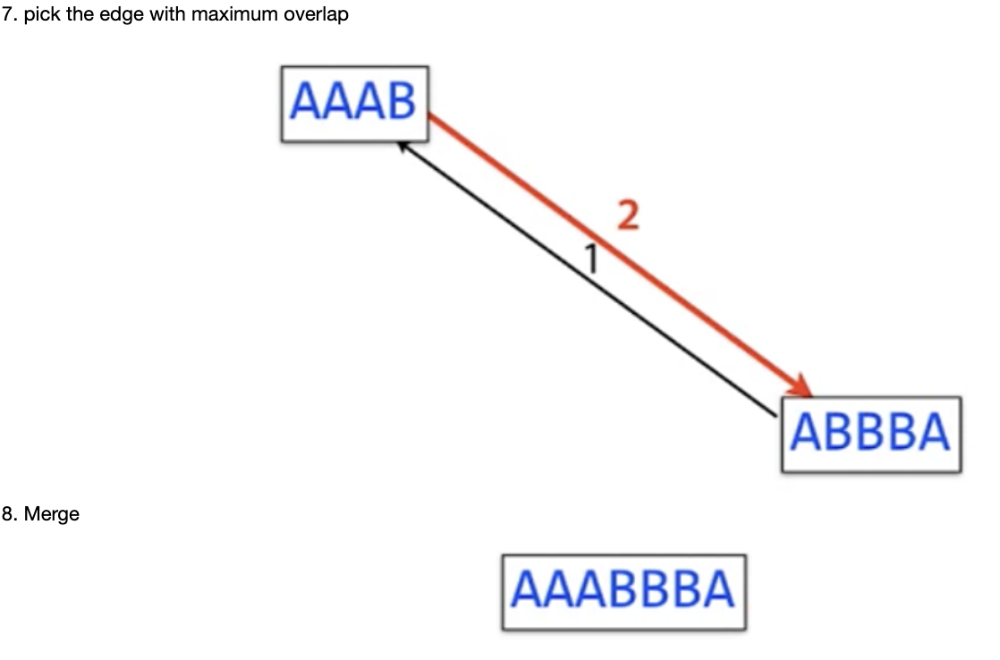

# Brute Force vs Greedy Algorithm:

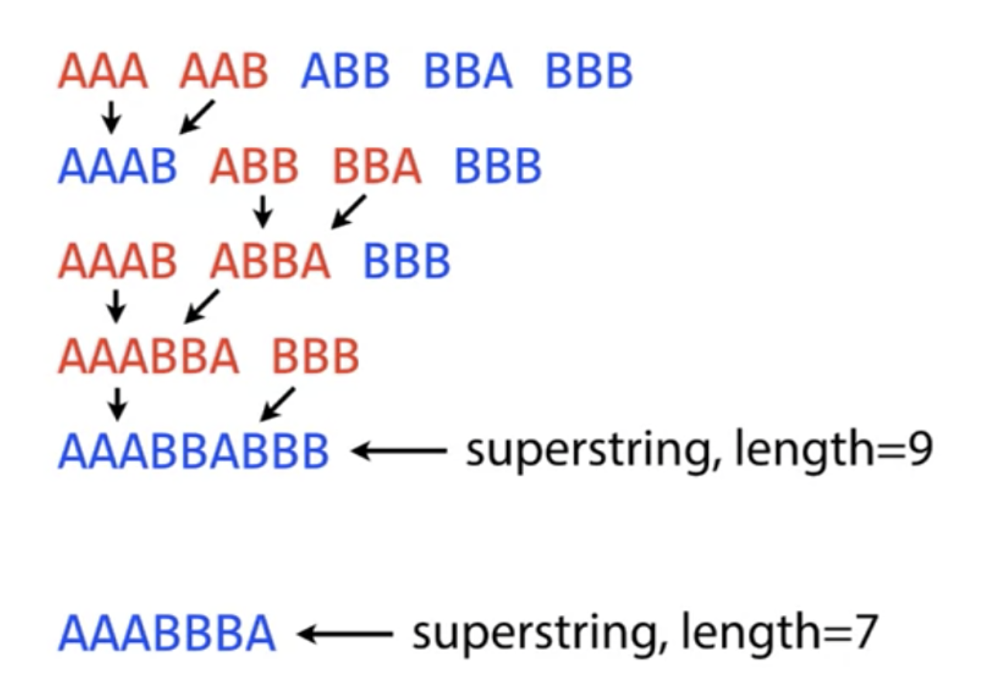

# Python Script for Greedy Algorithm:

In [697]:
def pick_maximal_overlap(reads, k):
    reada, readb = None, None
    best_olen = 0
    for a , b in itertools.permutations(reads, 2):
        olen = overlap(a, b, min_length=k)
        if olen > best_olen:
            reada, readb = a, b
            best_olen = olen
    return reada, readb, best_olen

In [782]:
def greedy_scs(reads, k):
    read_a , read_b, olen = pick_maximal_overlap(reads, k)
    while olen > 0:
        reads.remove(read_a)
        reads.remove(read_b)
        reads.append(read_a + read_b[olen:])
        read_a, read_b, olen = pick_maximal_overlap(reads, k)
        return ''.join(reads)

    

In [784]:
def pick_max_overlap(reads, k):
    best_a, best_b, best_len = None, None, 0
    for a, b in itertools.permutations(reads, 2):
        length = overlap(a, b, min_length=k)
        if length > best_len:
            best_a, best_b, best_len = a, b, length
    return best_a, best_b, best_len

def greedy_scs2(reads, k):
    while True:
        a, b, olen = pick_max_overlap(reads, k)
        if olen == 0:
            break
        reads.remove(a)
        reads.remove(b)
        reads.append(a + b[olen:])
    return ''.join(reads) # append all non-overlaps onto eachother and return the concatenated string    

### Example 1:

In [699]:
greedy_scs(['ABCD', 'CDBC', 'BCDA'], 1)

'CDBCABCDA'

In [785]:
greedy_scs2(['ABCD', 'CDBC', 'BCDA'], 1)

'CDBCABCDA'

In [701]:
scs(['ABCD', 'CDBC', 'BCDA'])

'ABCDBCDA'

---

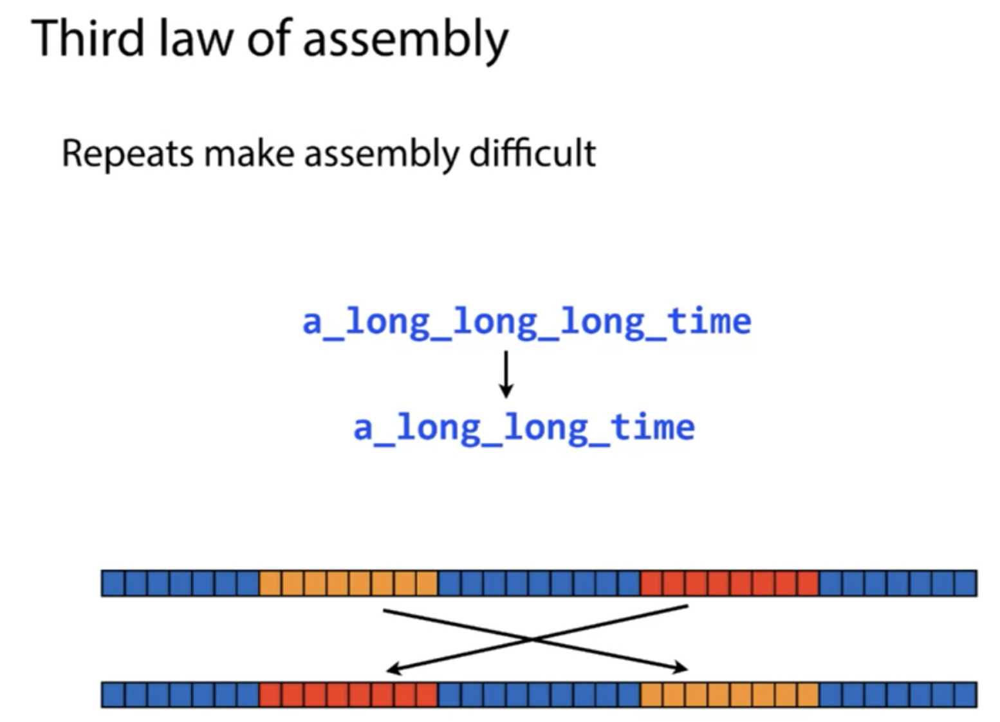

# |||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||||
# 
# Algorithm 3: De Bruijn  and Eulerian walks


# Procedure: 
# 
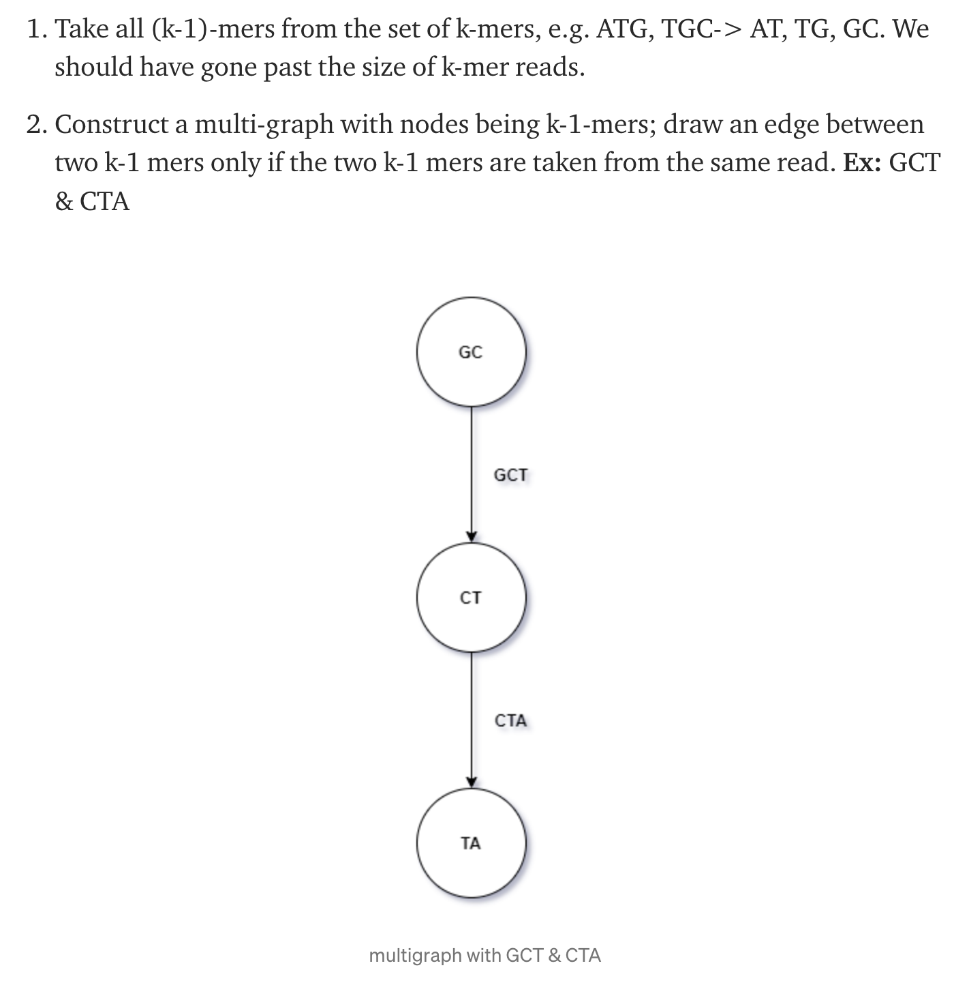
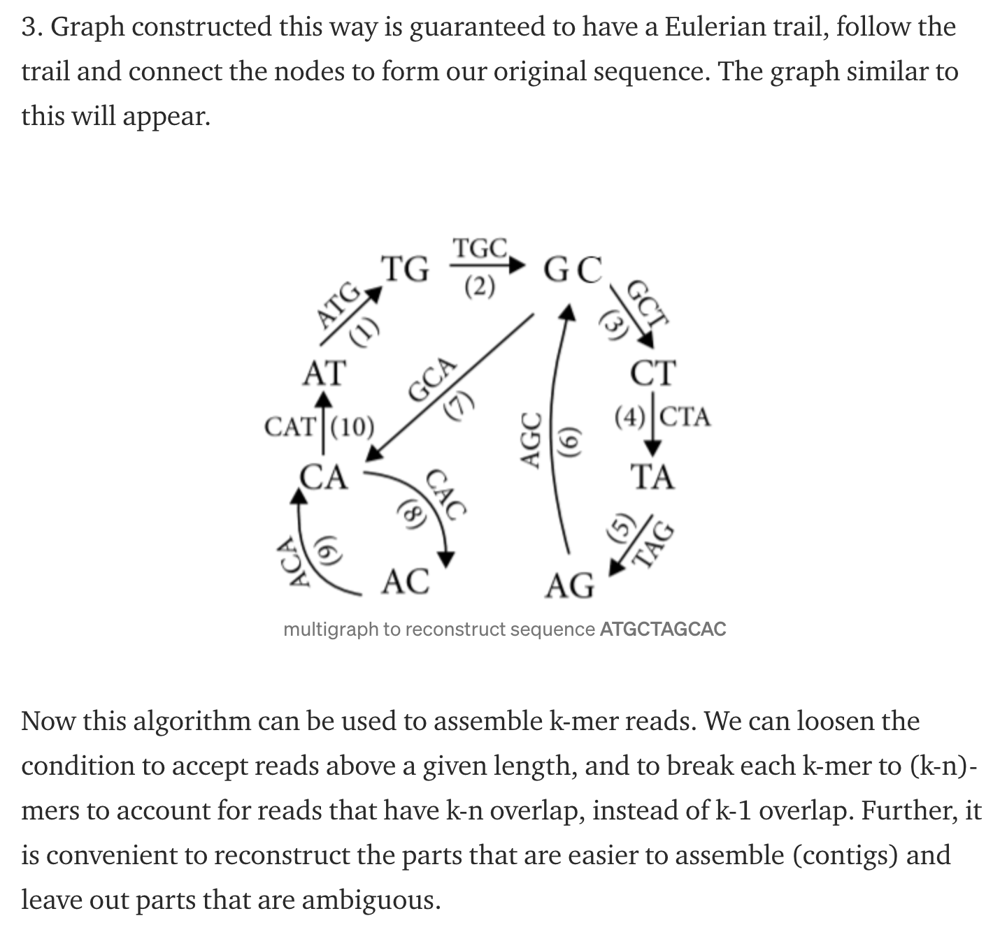

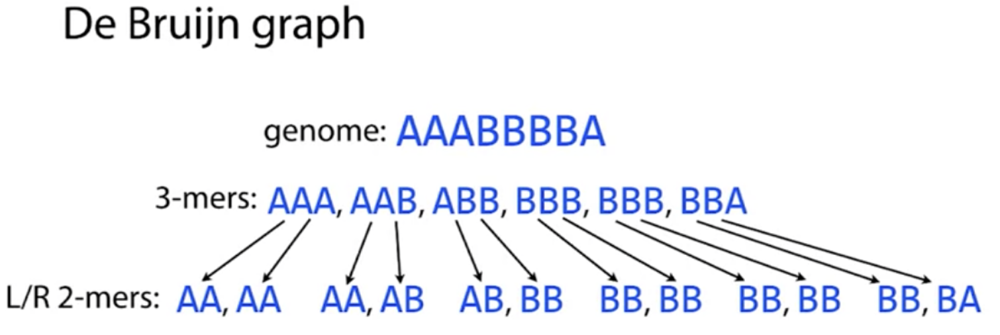
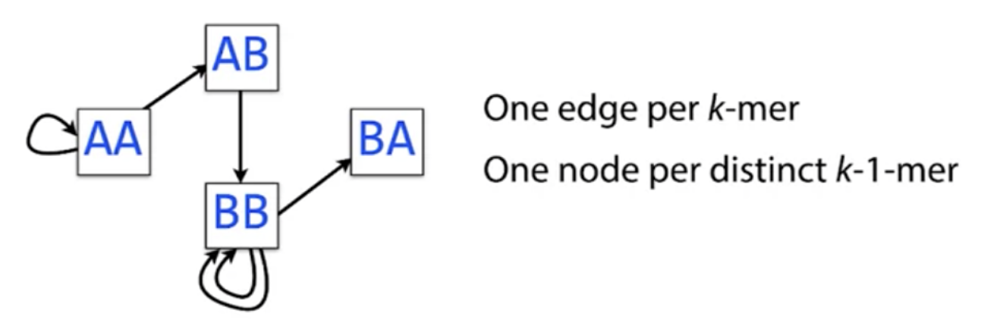
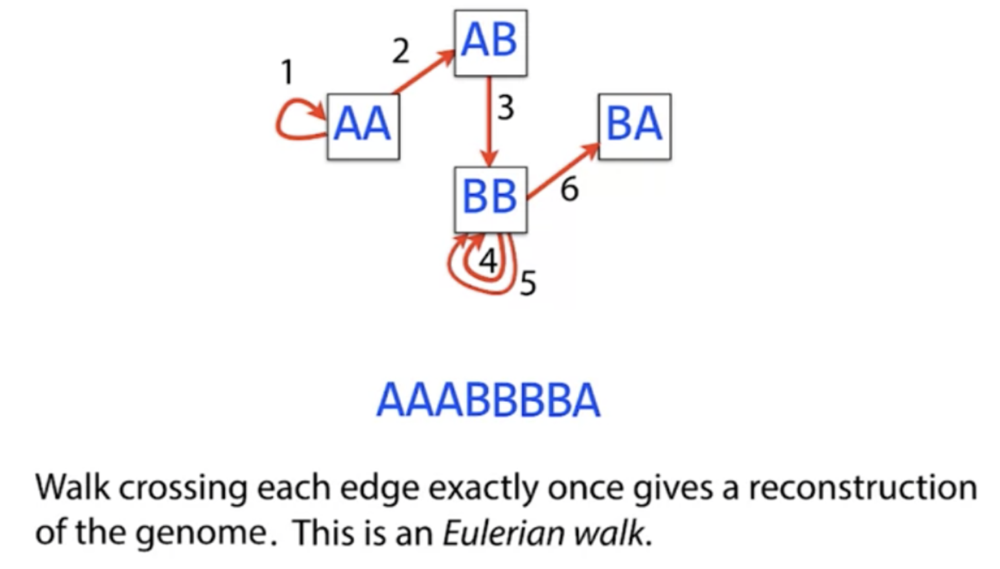

In [702]:
import gvmagic

In [703]:
def debruijnize(reads):
    nodes = set()
    not_starts = set()
    edges = []
    for r in reads:
        r1 = r[:-1]
        r2 = r[1:]
        nodes.add(r1)
        nodes.add(r2)
        edges.append((r1,r2))
        not_starts.add(r2)
    return (nodes,edges,list(nodes-not_starts))


def build_k_mer(str,k):
    return [str[i:k+i] for i in range(0,len(str)-k+1)]


def make_node_edge_map(edges):
    node_edge_map = {}
    for e in edges:
        n = e[0]
        if n in node_edge_map:
            node_edge_map[n].append(e[1])
        else:
            node_edge_map[n] = [e[1]]
    return node_edge_map


def eulerian_trail(m,v):
    nemap = m
    result_trail = []
    start = v
    result_trail.append(start)
    while(True):
        trail = []
        previous = start
        while(True):
            
            if(previous not in nemap):
                break
            next = nemap[previous].pop()
            if(len(nemap[previous]) == 0):
                nemap.pop(previous,None)
            trail.append(next)
            if(next == start):
                break;
            previous = next
        # completed one trail
        print(trail)
        index = result_trail.index(start)
        result_trail = result_trail[0:index+1] + trail + result_trail[index+1:len(result_trail)]
        # choose new start
        if(len(nemap)==0):
          break
        found_new_start = False
        for n in result_trail:
            if n in nemap:
                start = n
                found_new_start = True
                break # from for loop
        if not found_new_start:
            print("error")
            print("result_trail",result_trail)
            print(nemap)
            break
    return result_trail
def visualize_debruijn(G):
    nodes = G[0]
    edges = G[1]
    dot_str= 'digraph "DeBruijn graph" {\n '
    for node in nodes:
        dot_str += '    %s [label="%s"] ;\n' %(node,node)
    for src,dst in edges:
        dot_str += '    %s->%s;\n' %(src,dst)
    return dot_str + '}\n'


def assemble_trail(trail):
    if len(trail) == 0:
        return ""
    result = trail[0][:-1]
    for node in trail:
        result += node[-1]
    return result
def test_assembly_debruijn(t,k):
    reads = build_k_mer(t,k)
    G = debruijnize(reads)
    v = visualize_debruijn(G)
    nemap = make_node_edge_map(G[1])
    print(G)
    print(v)
    start = next(iter(G[2])) if (len(G[2]) > 0) else next(iter(G[0]))
    trail = eulerian_trail(nemap,start)
    return assemble_trail(trail)

# Example 1:

In [704]:
reads = build_k_mer("ATCGTTGCGCGACCG",4)
print(reads)

['ATCG', 'TCGT', 'CGTT', 'GTTG', 'TTGC', 'TGCG', 'GCGC', 'CGCG', 'GCGA', 'CGAC', 'GACC', 'ACCG']


In [705]:
G = debruijnize(reads)
print(G)

({'CGA', 'CGC', 'TCG', 'GTT', 'ACC', 'GAC', 'GCG', 'ATC', 'CCG', 'CGT', 'TTG', 'TGC'}, [('ATC', 'TCG'), ('TCG', 'CGT'), ('CGT', 'GTT'), ('GTT', 'TTG'), ('TTG', 'TGC'), ('TGC', 'GCG'), ('GCG', 'CGC'), ('CGC', 'GCG'), ('GCG', 'CGA'), ('CGA', 'GAC'), ('GAC', 'ACC'), ('ACC', 'CCG')], ['ATC'])


In [706]:
m = make_node_edge_map(G[1])
print(m)

{'ATC': ['TCG'], 'TCG': ['CGT'], 'CGT': ['GTT'], 'GTT': ['TTG'], 'TTG': ['TGC'], 'TGC': ['GCG'], 'GCG': ['CGC', 'CGA'], 'CGC': ['GCG'], 'CGA': ['GAC'], 'GAC': ['ACC'], 'ACC': ['CCG']}


In [707]:
start = G[2][0] if (len(G[2]) > 0) else G[0][0]
print (m)

{'ATC': ['TCG'], 'TCG': ['CGT'], 'CGT': ['GTT'], 'GTT': ['TTG'], 'TTG': ['TGC'], 'TGC': ['GCG'], 'GCG': ['CGC', 'CGA'], 'CGC': ['GCG'], 'CGA': ['GAC'], 'GAC': ['ACC'], 'ACC': ['CCG']}


In [708]:
t = eulerian_trail(m,start)
print(t)

['TCG', 'CGT', 'GTT', 'TTG', 'TGC', 'GCG', 'CGA', 'GAC', 'ACC', 'CCG']
['CGC', 'GCG']
['ATC', 'TCG', 'CGT', 'GTT', 'TTG', 'TGC', 'GCG', 'CGC', 'GCG', 'CGA', 'GAC', 'ACC', 'CCG']


In [709]:
get_ipython().magic(u'load_ext gvmagic')

In [712]:
# get_ipython().magic(u'dotstr visualize_debruijn(G)')


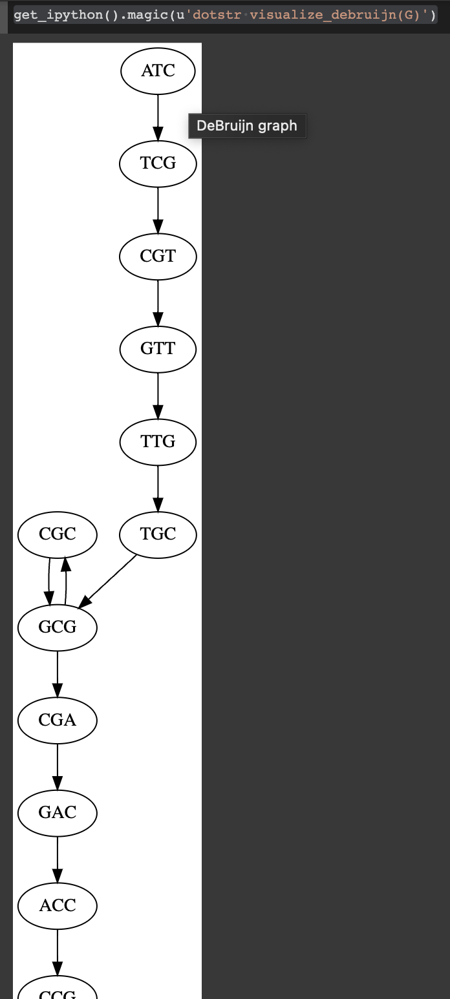

In [711]:
assemble_trail(t)

'ATCGTTGCGCGACCG'

# 
# 
# Week4: Programming Homework 4
# 

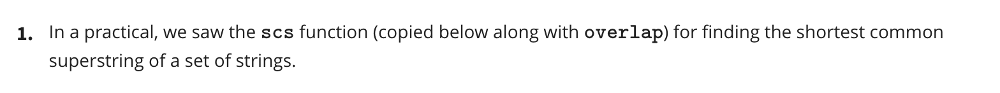

In [713]:
def overlap(a, b, min_length=3):
    """ Return length of longest suffix of 'a' matching
        a prefix of 'b' that is at least 'min_length'
        characters long.  If no such overlap exists,
        return 0. """
    start = 0  # start all the way at the left
    while True:
        start = a.find(b[:min_length], start)  # look for b's suffx in a
        if start == -1:  # no more occurrences to right
            return 0
        # found occurrence; check for full suffix/prefix match
        if b.startswith(a[start:]):
            return len(a)-start
        start += 1  # move just past previous match

import itertools

def scs(ss):
    """ Returns shortest common superstring of given
        strings, which must be the same length """
    shortest_sup = None
    for ssperm in itertools.permutations(ss):
        sup = ssperm[0]  # superstring starts as first string
        for i in range(len(ss)-1):
            # overlap adjacent strings A and B in the permutation
            olen = overlap(ssperm[i], ssperm[i+1], min_length=1)
            # add non-overlapping portion of B to superstring
            sup += ssperm[i+1][olen:]
        if shortest_sup is None or len(sup) < len(shortest_sup):
            shortest_sup = sup  # found shorter superstring
    return shortest_sup  # return shortest

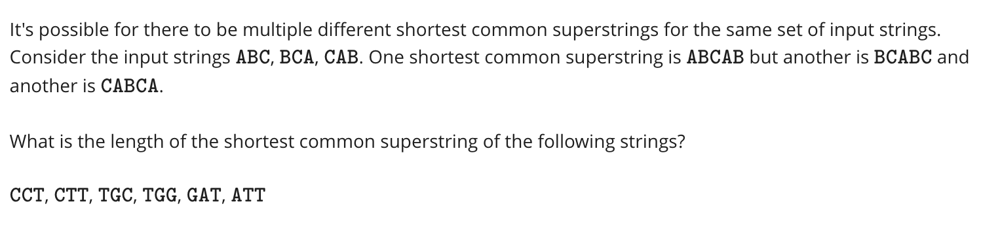

## Example 1:

In [716]:
scs_ = scs(['CCT', 'CTT', 'TGC', 'TGG', 'GAT', 'ATT'])
print(list(zip(['shortest common superstring:', 'its length:'], [scs_, len(scs_)])))

[('shortest common superstring:', 'CCTTGGATTGC'), ('its length:', 11)]


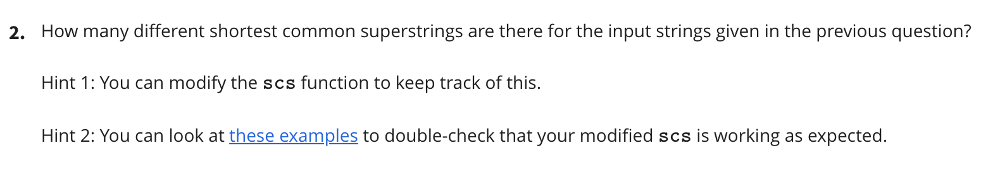

In [717]:
import itertools

def scs_list(ss):
    """ Returns shortest common superstring of given
        strings, which must be the same length """
    shortest_sup = None
    for ssperm in itertools.permutations(ss):
        sup = ssperm[0]  # superstring starts as first string
        for i in range(len(ss)-1):
            # overlap adjacent strings A and B in the permutation
            olen = overlap(ssperm[i], ssperm[i+1], min_length=1)
            # add non-overlapping portion of B to superstring
            sup += ssperm[i+1][olen:]
        if shortest_sup is None or len(sup) < len(min(shortest_sup)):
            if shortest_sup is None:
                shortest_sup = []
                shortest_sup.append(sup)
            else:
                shortest_sup = []
                shortest_sup.append(sup)
        elif len(sup) == len(min(shortest_sup)):
            shortest_sup.append(sup)
    shortest_sup.sort()
    return shortest_sup  # return shortest list

#Tests
strings = ['ABC', 'BCA', 'CAB']
assert(scs(strings)) == 'ABCAB'
assert(scs_list(strings)) == ['ABCAB', 'BCABC', 'CABCA']

strings = ['GAT', 'TAG', 'TCG', 'TGC', 'AAT', 'ATA']
assert(scs(strings)) == 'TCGATGCAATAG'
assert(scs_list(strings)) == ['AATAGATCGTGC','AATAGATGCTCG','AATAGTCGATGC','AATCGATAGTGC','AATGCTCGATAG','TCGAATAGATGC','TCGATAGAATGC','TCGATGCAATAG','TGCAATAGATCG','TGCAATCGATAG']

In [718]:
scs_list(['CCT', 'CTT', 'TGC', 'TGG', 'GAT', 'ATT'])

['CCTTGGATTGC', 'GATTGCCTTGG', 'TGCCTTGGATT', 'TGGATTGCCTT']

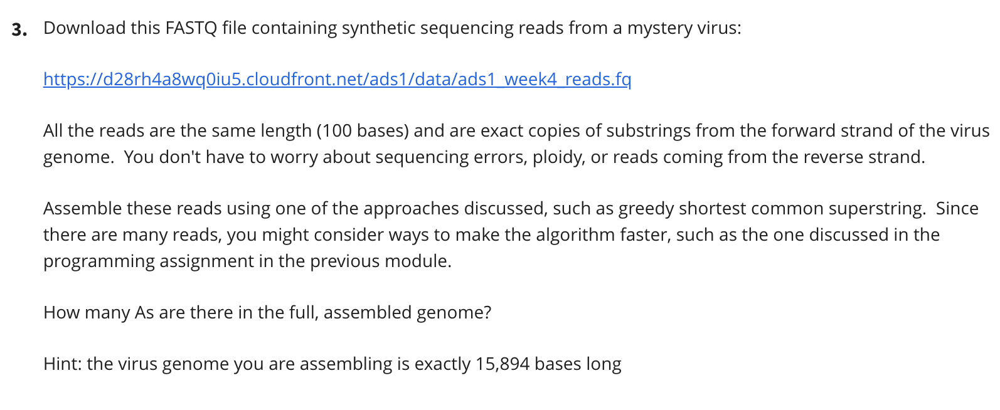

In [768]:
seqs, _ = readFastq('week4_Algorithms_for_assembly/ads1_week4_reads.fq')

In [769]:
seqs[:3]

['GTCCAGCAGAGCAAGTGATGCGAGAGCTGCCCATCCTCCAACCAGCATGCCCCTAGACATTGACACTGCATCGGAGTCAGGCCAAGATCCGCAGGACAGT',
 'GGAGTACGACTTCAGAGATCTCACTTGGTGTATCAACCCGCCAGAGAGAATCAAATTGGATTATGATCAATACTGTGCAGATGTGGCTGCTGAAGAACTC',
 'GCAAATTTTGATCTCTCTTGGCTTCACAATCAATTCAACCATGACCCGAGATGTAGTCATACCCCTCCTCACAAACAACGATCTCTTAATAAGGATGGCA']

### Try Shortest Common Substring mthod:

In [773]:
# Note: This method takes a LONG time to complete!!!
# shorest_common_substring = scs(seqs)

### Try Greedy method:

In [788]:
greedy_genome2 = greedy_scs2(seqs, k=50)

In [789]:
len(greedy_genome2)

15894

In [790]:
count_ATGC_in_seqs(greedy_genome2)

Counter({'A': 4633, 'C': 3789, 'G': 3749, 'T': 3723})